# 1. Defining the Question
***

**Can we predict the availability of airbnb properties accross different cities?**

# 2. Data Collection
***

This dataset features Airbnb listing data for a range of properties in six different urban areas: Austin, Bangkok, Buenos Aires, Cape Town, Istanbul, and Melbournce. The data was sourced from https://insideairbnb.com/get-the-data/, a website that provides data and analysis on the impacts of Airbnb on residential communities. The data for each city was compiled between October and November 2021.

## Data Dictionary

| Column                            | Explanation                                                                                                                                                                                        |
| --------------------------------- | -------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------- |
| id                                | Airbnb's unique identifier for the listing                                                                                                                                                         |
| name                              |                                                                                                                                                                                                    |
| host\_id                          |                                                                                                                                                                                                    |
| host\_name                        |                                                                                                                                                                                                    |
| neighbourhood\_group              | The neighbourhood group as geocoded using the latitude and longitude against neighborhoods as defined by open or public digital shapefiles.                                                        |
| neighbourhood                     | The neighbourhood as geocoded using the latitude and longitude against neighborhoods as defined by open or public digital shapefiles.                                                              |
| latitude                          | Uses the World Geodetic System (WGS84) projection for latitude and longitude.                                                                                                                      |
| longitude                         | Uses the World Geodetic System (WGS84) projection for latitude and longitude.                                                                                                                      |
| room\_type                        |                                                                                                                                                                                                    |
| price                             | daily price in local currency. Note, $ sign may be used despite locale                                                                                                                             |
| minimum\_nights                   | minimum number of night stay for the listing (calendar rules may be different)                                                                                                                     |
| number\_of\_reviews               | The number of reviews the listing has                                                                                                                                                              |
| last\_review                      | The date of the last/newest review                                                                                                                                                                 |
| calculated\_host\_listings\_count | The number of listings the host has in the current scrape, in the city/region geography.                                                                                                           |
| availability\_365                 | avaliability\_x. The availability of the listing x days in the future as determined by the calendar. Note a listing may be available because it has been booked by a guest or blocked by the host. |
| number\_of\_reviews\_ltm          | The number of reviews the listing has (in the last 12 months)                                                                                                                                      |
| license                           |                                                                                                                                                                                                    |

# 3. Data Preperation and Cleaning
***

## **Libraries**

In [5]:
# General purpose
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Modeling
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import LabelEncoder
import statsmodels.api as sm
from sklearn.metrics import mean_squared_error
from numpy.polynomial.polynomial import Polynomial
from scipy.optimize import curve_fit

### **Data**

In [6]:
# Read and append with modification to add city column at the beginning and capitalize city names
cities = ['austin', 'bangkok', 'buenos_aires', 'cape_town', 'istanbul', 'melbourne']

# Initial read to create DataFrame structure and add 'city' column at the beginning with capitalized city name
listings = pd.read_csv('data/listings_' + cities[0] + '.csv')
listings.insert(0, 'city', cities[0].capitalize())  # Insert 'city' column at the beginning and capitalize

for c in cities[1:]:  # Subsequent reads to append with capitalized city names
    temp_df = pd.read_csv('data/listings_' + c + '.csv')
    temp_df.insert(0, 'city', c.capitalize())  # Insert 'city' column at the beginning and capitalize
    listings = listings.append(temp_df)

# Reshuffle then view DataFrame 
listings.sample(frac=1, random_state=111).head(10)

,city,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
849,Bangkok,5582750,iSanook Eco Studio 2,8663142,ISanook Hotel,NaN,Bang Rak,13.73445,100.52173,Private room,1500,30,3,2015-12-24,0.04,39,365,0,NaN
4667,Melbourne,17908136,BOUTIQUE STAYS - River Boulevard,760849,Boutique Stays Accommodation Group,NaN,Yarra,-37.81278,145.01331,Entire home/apt,324,3,5,2021-02-20,0.14,61,363,1,NaN
11465,Istanbul,42575415,Sirkeci bölgesindekeyifli bir suit otel.,338475209,Karamans Si̇rkeci̇,NaN,Fatih,41.01093,28.97458,Private room,500,2,2,2021-07-09,0.54,3,358,2,NaN
14160,Melbourne,42184522,Luxury Apartment - Affinity 302,14990671,Melinda & Steve,NaN,Yarra,-37.78984,144.99134,Entire home/apt,140,7,2,2021-07-10,0.10,2,203,1,NaN
8242,Melbourne,26501587,Cosy 2 Bedroom LongStay Spring Deal ★Wi-Fi★Par...,581252,Sally,NaN,Port Phillip,-37.85243,144.97988,Entire home/apt,116,5,78,2019-12-20,1.96,1,90,12,NaN
17550,Melbourne,51694933,Spacious 1 Bedroom Riverfront Apartment with S...,34791641,Stay Partner,NaN,Melbourne,-37.82310,144.96262,Entire home/apt,142,14,0,NaN,NaN,12,88,0,NaN
17155,Melbourne,50607670,Lovely entire apartment in central Fitzroy,67718173,Victoria,NaN,Yarra,-37.80611,144.97752,Entire home/apt,125,2,1,2021-07-04,0.24,1,0,1,NaN
15012,Cape_town,48704426,Bold and Modern Aparthotel in Cape Town,154717740,Lize,NaN,Ward 59,-33.95887,18.46929,Private room,619,1,2,2021-09-19,0.88,1,306,2,NaN
13553,Cape_town,45510549,★2 Bedroom ★ Rondebosch★ WiFi + Netflix ★Disco...,87234125,Evolve,NaN,Ward 59,-33.95692,18.47150,Entire home/apt,1007,5,4,2021-04-30,0.36,27,183,4,NaN
6763,Bangkok,26417751,2-bed 95m2 apt nice view near Emporium,171082741,Wiset,NaN,Vadhana,13.74284,100.56918,Entire home/apt,1399,2,27,2018-11-05,0.70,22,90,0,NaN


Check for duplicates

In [7]:
# Checking for duplicates in the 'listings' DataFrame
duplicates = listings.duplicated().sum()
print("Total duplicates: " , duplicates)

Total duplicates:  0


Find which columns have the most missing data.

In [8]:
# Calculate the percentage of missing data for each column in the 'listings' DataFrame and filter out columns with 0% missing data
missing_data_percentage = listings.isnull().mean() * 100
missing_data_percentage_filtered = missing_data_percentage[missing_data_percentage > 0]

# Sort the filtered columns by the percentage of missing data in descending order
missing_data_percentage_sorted = missing_data_percentage_filtered.sort_values(ascending=False)

# Display the sorted percentages
missing_data_percentage_sorted

neighbourhood_group    100.000000
license                 99.899824
last_review             33.600470
reviews_per_month       33.600470
host_name                0.068390
name                     0.038529
dtype: float64

Looking through the data, we can see a few things. 
Most noticably, "neighbourhood_group", "neighbourhood", and "licesnse" have an exceptional amount of null values.
We can also see that currencies need to be converted to USD.
Also, removing latitude and longitude would help clean up our data since its not useful for us. And would be difficult to make any analysis from coordinates.


**Converting all Currencies to USD**

In [9]:
# Conversion rates from local currency to USD
conversion_rates = {'austin': 1, 'bangkok': 0.027, 'buenos_aires': 0.0012, 'cape_town': 0.052, 'istanbul': 0.031, 'melbourne': 0.64}

# Apply conversion rates to the 'price' column based on the 'city' column to create a new 'price_USD' column
listings['price_USD'] = listings.apply(lambda row: row['price'] * conversion_rates[row['city'].lower().replace(" ", "_")], axis=1)

In [10]:
listings.drop(['neighbourhood_group', 'neighbourhood', 'license', 'latitude', 'longitude', 'last_review'], axis=1, inplace=True)

Data Types

In [11]:
listings.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 103817 entries, 0 to 18015
Data columns (total 14 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   city                            103817 non-null  object 
 1   id                              103817 non-null  int64  
 2   name                            103777 non-null  object 
 3   host_id                         103817 non-null  int64  
 4   host_name                       103746 non-null  object 
 5   room_type                       103817 non-null  object 
 6   price                           103817 non-null  int64  
 7   minimum_nights                  103817 non-null  int64  
 8   number_of_reviews               103817 non-null  int64  
 9   reviews_per_month               68934 non-null   float64
 10  calculated_host_listings_count  103817 non-null  int64  
 11  availability_365                103817 non-null  int64  
 12  number_of_reviews

Let's convert:
* **name** and **host_name** to string
* **room_type** and **city** to category
* **last_review** to datetime

In [12]:
# Converting data types as specified
listings['name'] = listings['name'].astype('string')
listings['host_name'] = listings['host_name'].astype('string')
listings['room_type'] = listings['room_type'].astype('category')
listings['city'] = listings['city'].astype('category')

Now that we have cleaned our data, we can analyze each city indivually

Let's find max and min values for each category to see if there are any relationships

In [13]:
listings.describe()

,id,host_id,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,price_USD
count,1.038170e+05,1.038170e+05,103817.000000,103817.000000,103817.000000,68934.000000,103817.000000,103817.000000,103817.000000,103817.000000
mean,3.103425e+07,1.360252e+08,1987.914234,7.536348,18.319553,1.098186,9.104588,216.562191,3.273491,86.961641
std,1.516060e+07,1.252699e+08,14157.442834,30.517800,43.025894,3.232729,24.149212,139.114813,9.362235,271.544476
min,2.265000e+03,2.300000e+01,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000,0.000000,0.000000
25%,1.905071e+07,2.559230e+07,208.000000,1.000000,0.000000,0.120000,1.000000,88.000000,0.000000,10.974000
50%,3.347757e+07,9.513946e+07,667.000000,2.000000,2.000000,0.440000,2.000000,250.000000,0.000000,31.860000
75%,4.328060e+07,2.312255e+08,1771.000000,4.000000,16.000000,1.220000,6.000000,361.000000,2.000000,81.000000
max,5.318982e+07,4.304587e+08,997739.000000,1125.000000,1116.000000,305.000000,293.000000,365.000000,351.000000,12980.000000


In [14]:
# View its summary statistics for string fields
listings[['name', 'host_name', 'room_type', 'city']].describe().reset_index()

,index,name,host_name,room_type,city
0,count,103777,103746,103817,103817
1,unique,99511,20738,4,6
2,top,New! La Chada Night Market studio 2PPL near MRT,David,Entire home/apt,Istanbul
3,freq,46,407,69425,22539


In [15]:
max_values = listings.max()
min_values = listings.min()

# Initialize a DataFrame to store the results
max_min_values = pd.DataFrame(columns=['Max Values', 'Max City', 'Min Values', 'Min City'])

# Loop through each numerical column to find the max and min values and the associated cities
for column in listings.select_dtypes(include=['number']).columns:
    max_row = listings.loc[listings[column] == listings[column].max()]
    min_row = listings.loc[listings[column] == listings[column].min()]
    
    # Append the max and min values and cities to the DataFrame
    max_min_values = max_min_values.append({
        'Max Values': max_row[column].iloc[0],
        'Max City': max_row['city'].iloc[0],
        'Min Values': min_row[column].iloc[0],
        'Min City': min_row['city'].iloc[0]
    }, ignore_index=True)

max_min_values.index = listings.select_dtypes(include=['number']).columns
max_min_values.T  # Transpose for a better overview

,id,host_id,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,price_USD
Max Values,53189820,430458694,997739,1125,1116,305.0,293,365,351,12980.0
Max City,Melbourne,Melbourne,Buenos_aires,Melbourne,Bangkok,Austin,Austin,Austin,Austin,Austin
Min Values,2265,23,0,1,0,0.01,1,0,0,0.0
Min City,Austin,Austin,Austin,Austin,Austin,Austin,Austin,Austin,Austin,Austin


For more accurate models, lets scale our data using either min max, or zcore normalization

In [16]:
# Creating a new DataFrame 'listings_norm' as a copy of 'listings' to preserve the original data
listings_norm = listings.copy()

# Applying Min-Max Normalization to columns 7 to 13 of the 'listings_norm' DataFrame and replacing the old columns
columns_to_normalize = listings_norm.columns[7:14]  # Selecting columns by their index

for column in columns_to_normalize:
    listings_norm[column] = (listings_norm[column] - listings_norm[column].min()) / (listings_norm[column].max() - listings_norm[column].min())

listings_norm.head()  # Display the first few rows to check the DataFrame after columns removal

,city,id,name,host_id,host_name,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,price_USD
0,Austin,2265,Zen-East in the Heart of Austin (monthly rental),2466,Paddy,Entire home/apt,179,0.005338,0.023297,0.001148,0.006849,0.095890,0.005698,0.013790
1,Austin,5245,"Eco friendly, Colorful, Clean, Cozy monthly share",2466,Paddy,Private room,114,0.025801,0.008065,0.000656,0.006849,0.000000,0.000000,0.008783
2,Austin,5456,"Walk to 6th, Rainey St and Convention Ctr",8028,Sylvia,Entire home/apt,108,0.000890,0.515233,0.079183,0.000000,0.887671,0.111111,0.008320
3,Austin,5769,NW Austin Room,8186,Elizabeth,Private room,39,0.000000,0.236559,0.019476,0.000000,0.000000,0.019943,0.003005
4,Austin,6413,Gem of a Studio near Downtown,13879,Todd,Entire home/apt,109,0.001779,0.104839,0.004131,0.000000,0.000000,0.011396,0.008398


In [17]:
# Creating a new DataFrame 'listings_norm' as a copy of 'listings' to preserve the original data
listingz = listings.copy()

# Applying Z-Score Normalization to columns 7 to 13 of the 'listings_norm' DataFrame and replacing the old columns
columns_to_normalize = listingz.columns[7:14]  # Selecting columns by their index

for column in columns_to_normalize:
    listingz[column] = (listingz[column] - listingz[column].mean()) / listingz[column].std()

listingz.head()  # Display the first few rows to check the DataFrame after normalization


,city,id,name,host_id,host_name,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,price_USD
0,Austin,2265,Zen-East in the Heart of Austin (monthly rental),2466,Paddy,Entire home/apt,179,-0.017575,0.178508,-0.228348,-0.252786,-1.305125,-0.136024,0.338944
1,Austin,5245,"Eco friendly, Colorful, Clean, Cozy monthly share",2466,Paddy,Private room,114,0.736084,-0.216603,-0.274748,-0.252786,-1.556716,-0.349648,0.099572
2,Austin,5456,"Walk to 6th, Rainey St and Convention Ctr",8028,Sylvia,Entire home/apt,108,-0.181414,12.938266,7.133854,-0.335605,0.772296,3.816024,0.077477
3,Austin,5769,NW Austin Room,8186,Elizabeth,Private room,39,-0.214181,5.710060,1.500842,-0.335605,-1.556716,0.398036,-0.176625
4,Austin,6413,Gem of a Studio near Downtown,13879,Todd,Entire home/apt,109,-0.148646,2.293513,0.053148,-0.335605,-1.556716,0.077600,0.081159


Data cleaning with this chart.
Seperate this info with a table and make it more readable. Highlight the relationships that are easily seen

Based on this data we can see that there is a potential relationship between availability_365 and calculated_host_listings_count, number_of_reviews, and reviews_per_month

We will explore relationships between variables and each individual city further

**Heatmap of Availability_365 for Each City**

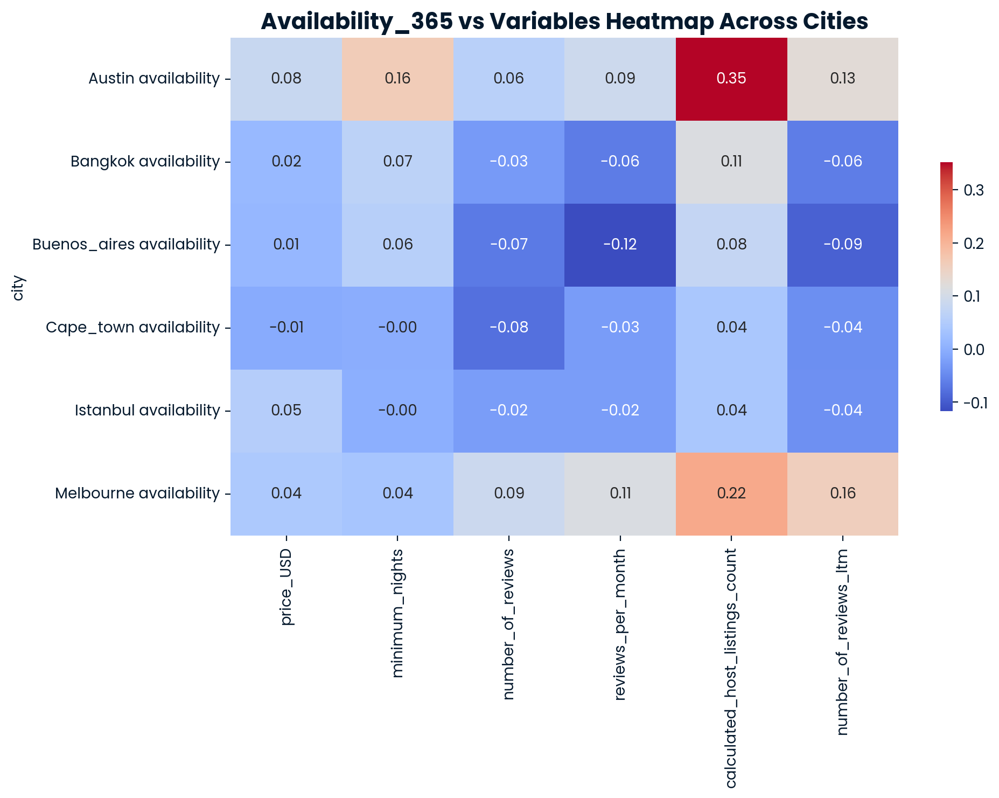

In [18]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'cities' is a list of unique cities in the 'listings' dataframe
cities = listings['city'].unique()

# Initialize an empty dataframe to store the combined correlation data
combined_corr_data = pd.DataFrame()

for city in cities:
    # Filter the listings for the current city
    city_listings = listings[listings['city'] == city]
    
    # Drop the columns 'id', 'host_id', 'available' and keep only the specified columns for correlation
    columns_of_interest = ['price_USD', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 
                           'calculated_host_listings_count', 'number_of_reviews_ltm', 'availability_365']
    city_listings = city_listings[columns_of_interest]
    
    # Calculate the correlation matrix for the filtered city listings
    corr_city = city_listings.corr()
    
    # Extract the row for 'availability_365' to get its correlations with other specified variables
    corr_availability = corr_city.loc[['availability_365'], columns_of_interest[:-1]]  # Exclude 'availability_365' itself
    
    # Add a column to distinguish data from different cities
    corr_availability['city'] = city + " availability"
    
    # Append the data to the combined dataframe
    combined_corr_data = combined_corr_data.append(corr_availability)

# Set the 'city' column as the index to distinguish rows in the heatmap
combined_corr_data.set_index('city', inplace=True)

# Plot the heatmap for combined 'availability_365' correlations across all cities with specified variables
plt.figure(figsize=(10, 6))  # Adjusted figure size for better readability
sns.heatmap(combined_corr_data, annot=True, fmt=".2f", cmap='coolwarm', cbar_kws={'shrink': .5})
plt.title('Availability_365 vs Variables Heatmap Across Cities', fontsize=15, fontweight='bold')
plt.show()

# Price vs Availability

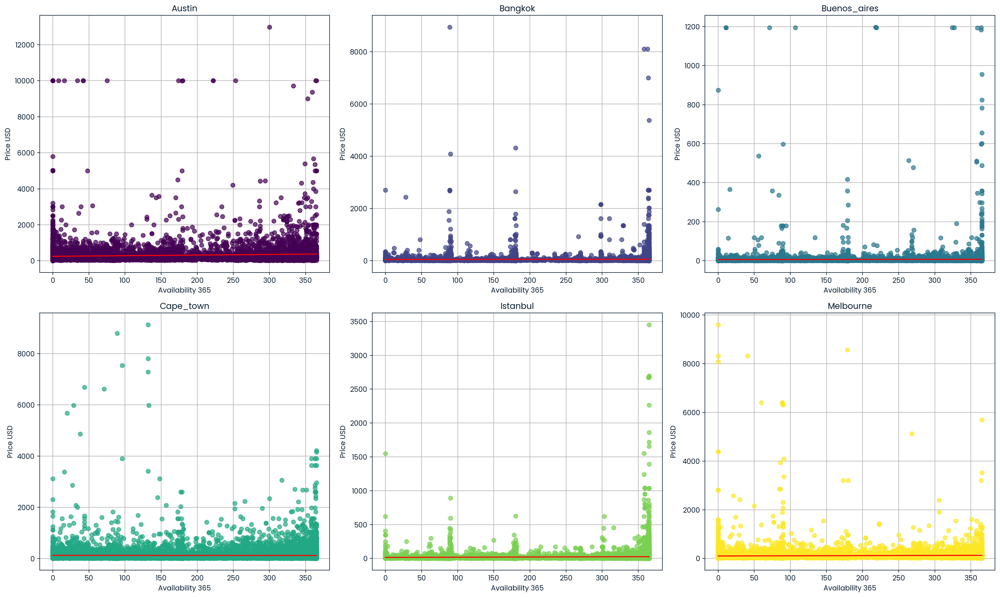

In [19]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    
    # Plotting the scatter plot
    ax.scatter(subset["availability_365"], subset["price_USD"], color=colors[i], alpha=0.7, zorder=2)
    
    # Fitting a line of best fit
    x = subset["availability_365"]
    y = subset["price_USD"]
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
    x_new = np.linspace(x.min(), x.max(), num=200)
    y_new = intercept + slope * x_new
    
    ax.plot(x_new, y_new, color="red", zorder=3)
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.grid(True, zorder=1)
    ax.set_ylabel('Price USD')

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# Price vs Availability - Log

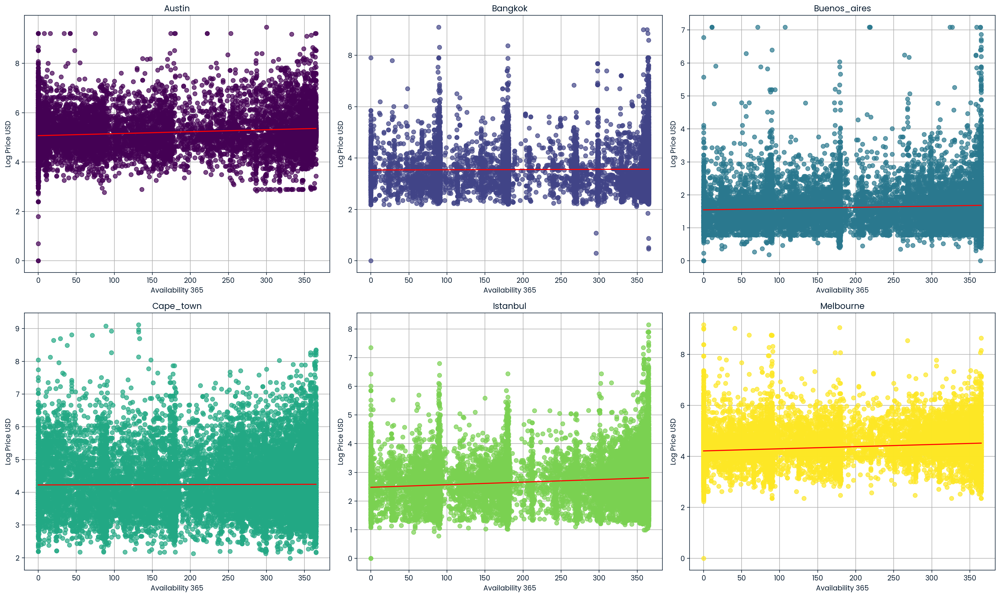

In [20]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    
    # Applying log transformation to price_USD to normalize distribution
    subset['log_price_USD'] = np.log(subset['price_USD'] + 1)  # Adding 1 to avoid log(0)
    
    # Plotting the scatter plot with log transformation
    ax.scatter(subset["availability_365"], subset["log_price_USD"], color=colors[i], alpha=0.7, zorder=2)
    
    # Fitting a line of best fit on the log-transformed prices
    x = subset["availability_365"]
    y = subset["log_price_USD"]
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
    x_new = np.linspace(x.min(), x.max(), num=200)
    y_new = intercept + slope * x_new
    
    ax.plot(x_new, y_new, color="red", zorder=3)
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.grid(True, zorder=1)
    ax.set_ylabel('Log Price USD')

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# Minimum Nights vs Availability 

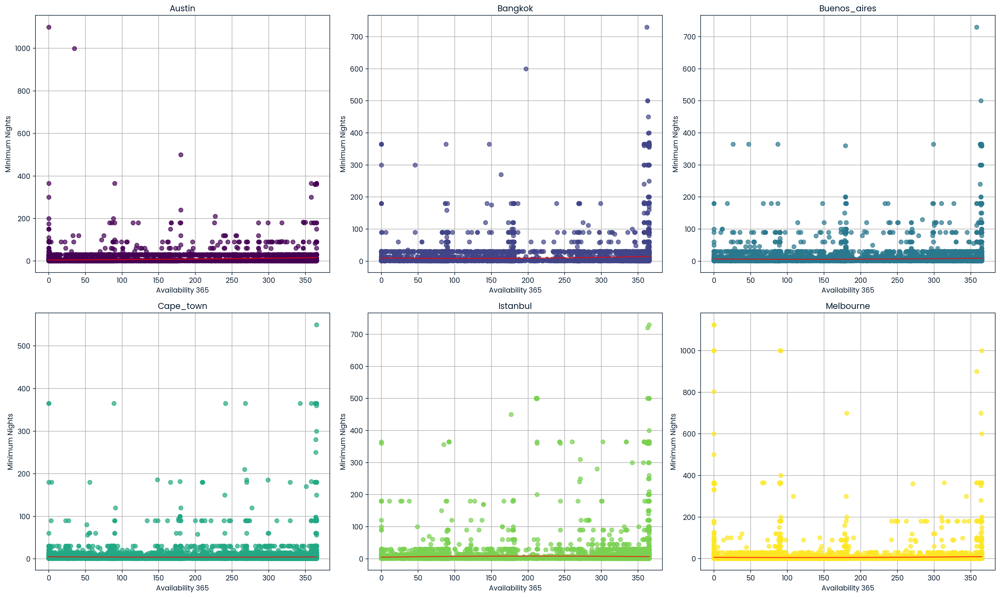

In [21]:
import numpy as np
import matplotlib.pyplot as plt
from numpy.polynomial.polynomial import Polynomial

cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    
    # Fit a polynomial (let's choose a 2nd degree polynomial for demonstration)
    x = subset["availability_365"]
    y = subset["minimum_nights"]
    coefs = Polynomial.fit(x, y, 2).convert().coef  # Fit and convert to standard polynomial form
    x_new = np.linspace(x.min(), x.max(), 200)
    y_fit = np.polyval(coefs[::-1], x_new)  # Calculate the fitted y values
    
    ax.plot(x, y, 'o', color=colors[i], alpha=0.7, zorder=2)  # Original data
    ax.plot(x_new, y_fit, '-', color='red', alpha=0.7, zorder=3)  # Line of best fit
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.set_ylabel('Minimum Nights')
    ax.grid(True, zorder=1)

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# Minimum Nights vs Availability - Log

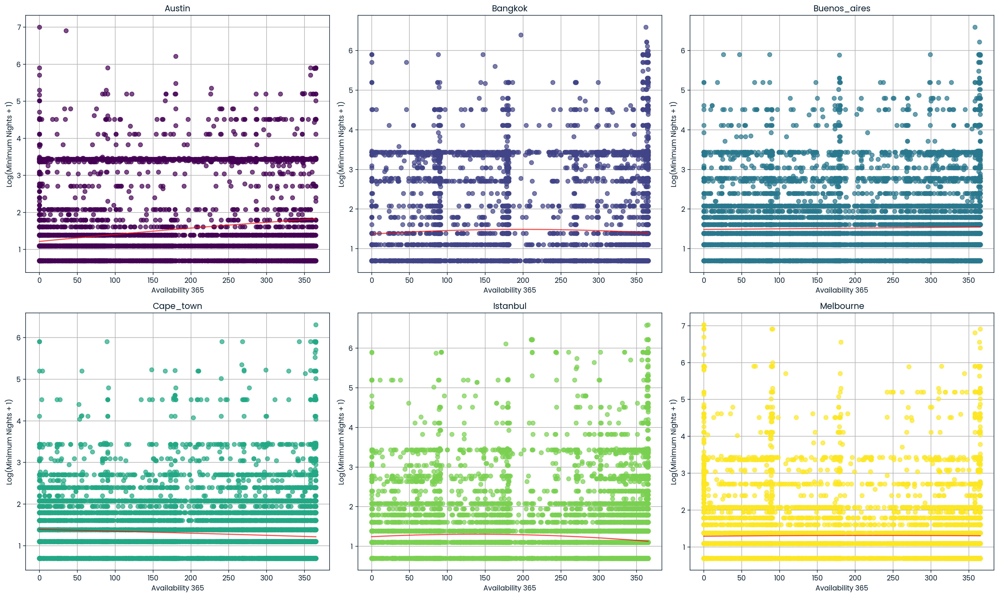

In [22]:
import numpy as np
import matplotlib.pyplot as plt
from numpy.polynomial.polynomial import Polynomial

cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    
    # Fit a polynomial (let's choose a 2nd degree polynomial for demonstration)
    x = subset["availability_365"]
    y = np.log(subset["minimum_nights"] + 1)  # Apply log transformation to minimum_nights to handle zero values
    coefs = Polynomial.fit(x, y, 2).convert().coef  # Fit and convert to standard polynomial form
    
    x_new = np.linspace(x.min(), x.max(), 200)
    y_fit = np.polyval(coefs[::-1], x_new)  # Calculate the fitted y values
    
    ax.plot(x, y, 'o', color=colors[i], alpha=0.7, zorder=2)  # Original data
    ax.plot(x_new, y_fit, '-', color='red', alpha=0.7, zorder=3)  # Line of best fit
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.set_ylabel('Log(Minimum Nights + 1)')
    ax.grid(True, zorder=1)

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# Number of Reviews vs Availability 

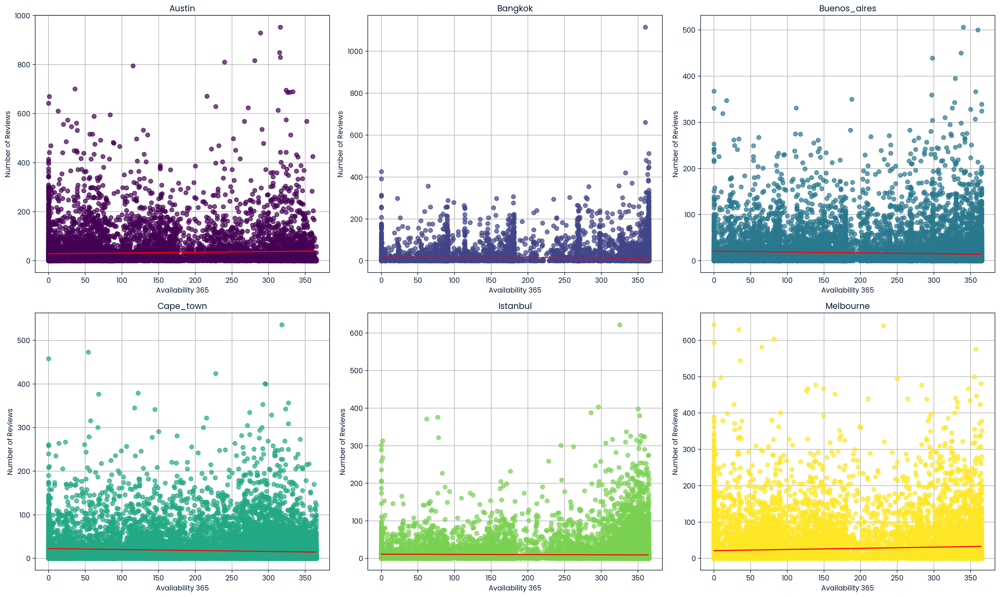

In [23]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

def linear_fit(x, a, b):
    return a * x + b

cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    
    # Scatter plot
    ax.scatter(subset["availability_365"], subset["number_of_reviews"], color=colors[i], alpha=0.7, zorder=2)
    
    # Fit line
    popt, _ = curve_fit(linear_fit, subset["availability_365"], subset["number_of_reviews"])
    x_line = np.arange(min(subset["availability_365"]), max(subset["availability_365"]), 1)
    y_line = linear_fit(x_line, *popt)
    ax.plot(x_line, y_line, '-', color='red')  # Line of best fit
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.set_ylabel('Number of Reviews')
    ax.grid(True, zorder=1)

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# Number of Reviews vs Availability - Log

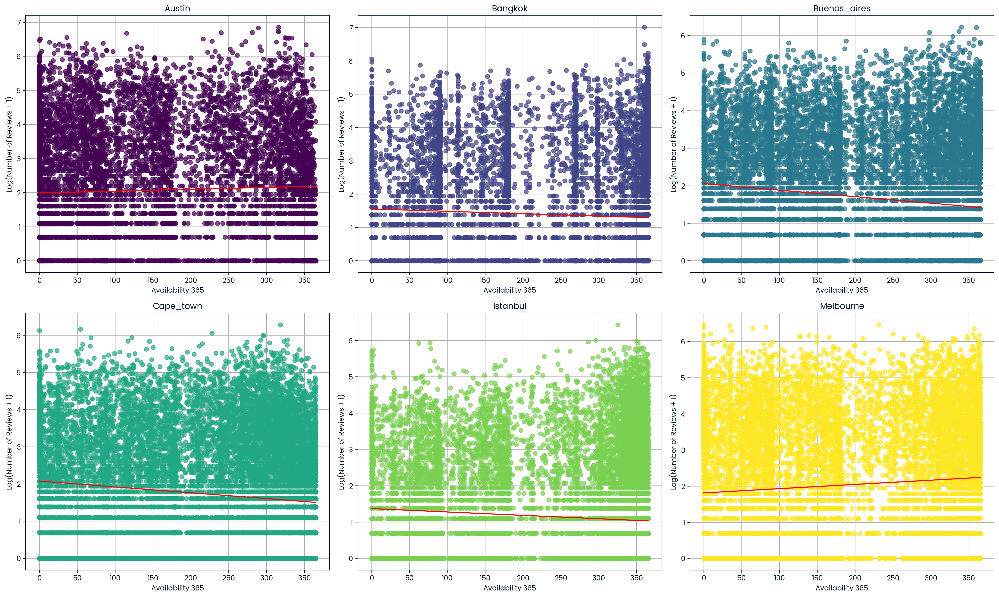

In [24]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# Function to fit a line
def linear_func(x, a, b):
    return a * x + b

cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    # Taking log of 'number_of_reviews' to plot
    ax.scatter(subset["availability_365"], np.log1p(subset["number_of_reviews"]), color=colors[i], alpha=0.7, zorder=2)  # Scatter plot for each city with log scale for number of reviews
    
    # Fit a line to the data
    xdata = subset["availability_365"]
    ydata = np.log1p(subset["number_of_reviews"])
    popt, pcov = curve_fit(linear_func, xdata, ydata)
    # Plot the fitted line
    x_fit = np.linspace(xdata.min(), xdata.max(), 100)
    y_fit = linear_func(x_fit, *popt)
    ax.plot(x_fit, y_fit, '-', color='red')  # Plotting the fitted line
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.set_ylabel('Log(Number of Reviews + 1)')
    ax.grid(True, zorder=1)

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# Number of Reviews in LTM vs Availability

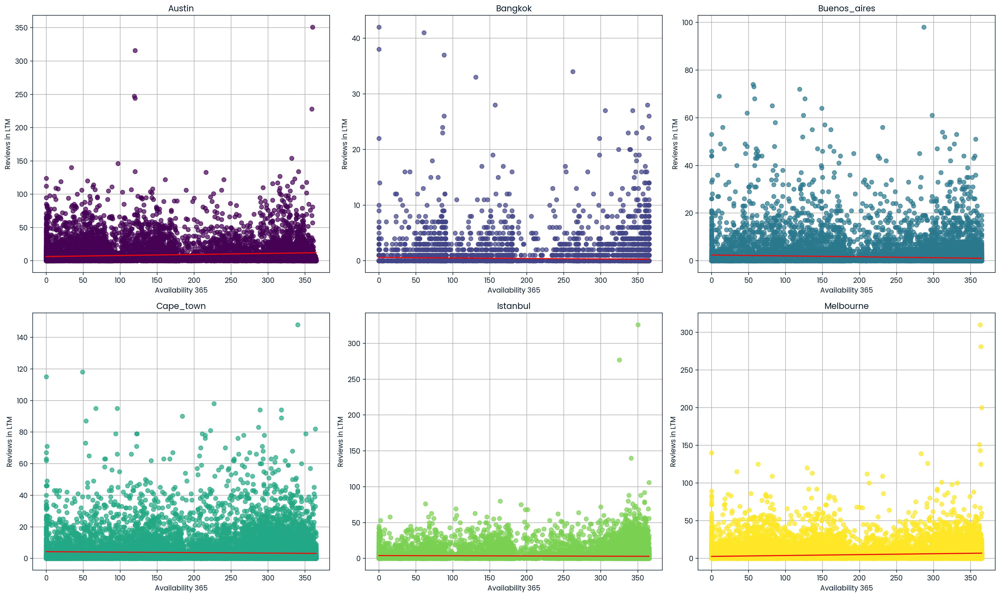

In [25]:
from scipy.optimize import curve_fit

def linear_fit(x, a, b):
    return a * x + b

cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    
    # Scatter plot
    ax.scatter(subset["availability_365"], subset["number_of_reviews_ltm"], color=colors[i], alpha=0.7, zorder=2)
    
    # Fit line
    x = subset["availability_365"]
    y = subset["number_of_reviews_ltm"]
    popt, _ = curve_fit(linear_fit, x, y)
    x_fit = np.linspace(x.min(), x.max(), 100)
    y_fit = linear_fit(x_fit, *popt)
    ax.plot(x_fit, y_fit, '-', color='red')  # Line of best fit
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.set_ylabel('Reviews in LTM')
    ax.grid(True, zorder=1)

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# Number of Reviews in LTM vs Availability - Log

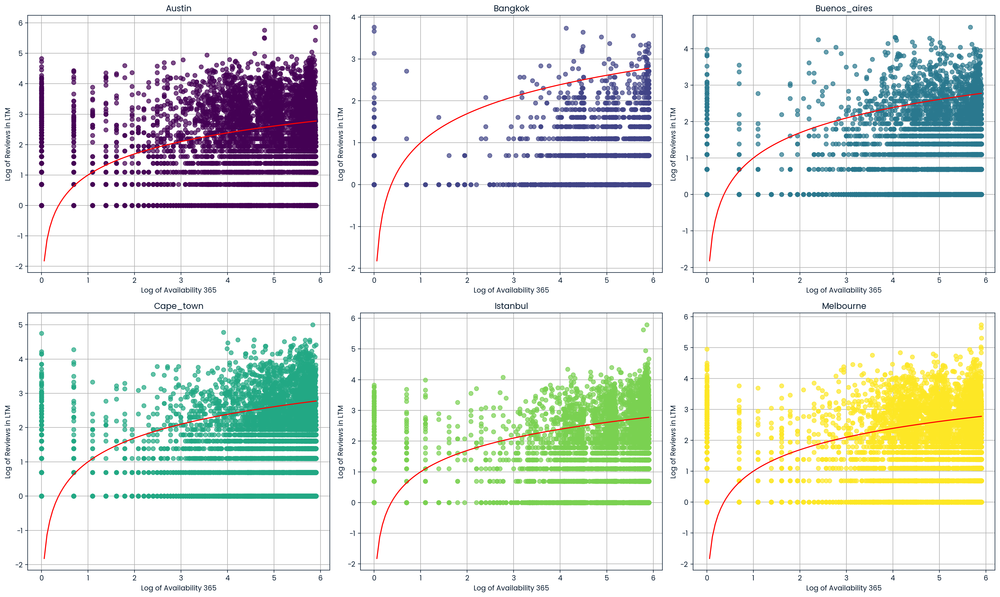

In [26]:


def linear_fit(x, a, b):
    return a * x + b

# Adjusting the function to work with log-transformed data
def log_linear_fit(x, a, b):
    return a * np.log(x) + b

cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    
    # Scatter plot with log transformation
    ax.scatter(np.log(subset["availability_365"] + 1), np.log(subset["number_of_reviews_ltm"] + 1), color=colors[i], alpha=0.7, zorder=2)
    
    # Fit line with log transformation
    x = np.log(subset["availability_365"] + 1)
    y = np.log(subset["number_of_reviews_ltm"] + 1)
    popt, _ = curve_fit(log_linear_fit, x, y)
    x_fit = np.linspace(x.min(), x.max(), 100)
    y_fit = log_linear_fit(x_fit, *popt)
    ax.plot(x_fit, y_fit, '-', color='red')  # Line of best fit
    
    ax.set_title(str(city))
    ax.set_xlabel('Log of Availability 365')
    ax.set_ylabel('Log of Reviews in LTM')
    ax.grid(True, zorder=1)

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# Calculated Hosts Listings Count vs Availability

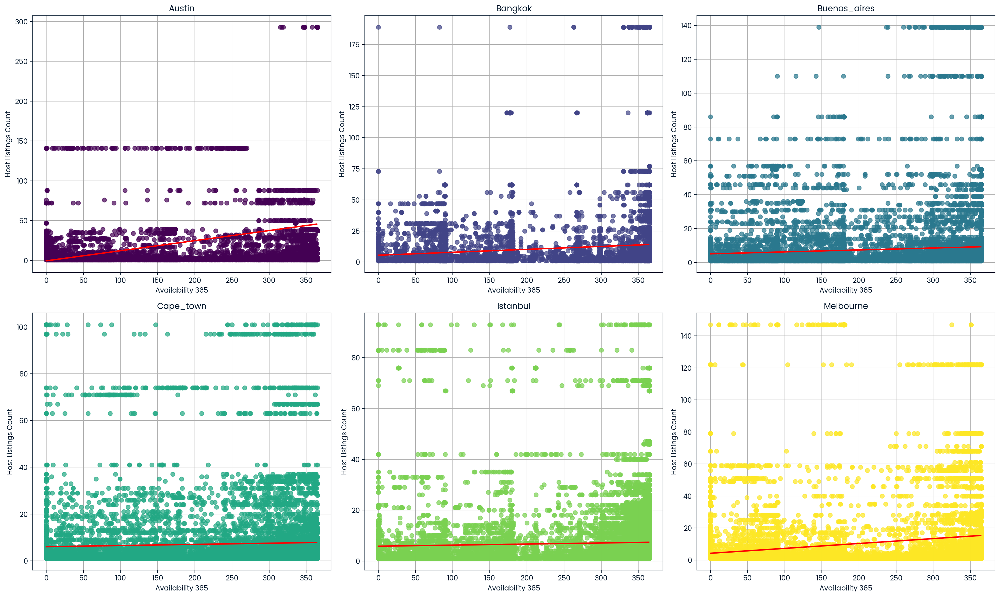

In [27]:


def linear_fit(x, a, b):
    return a * x + b

cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    
    # Scatter plot for each city
    ax.scatter(subset["availability_365"], subset["calculated_host_listings_count"], color=colors[i], alpha=0.7, zorder=2)
    
    # Fit line
    popt, _ = curve_fit(linear_fit, subset["availability_365"], subset["calculated_host_listings_count"])
    x_line = np.arange(min(subset["availability_365"]), max(subset["availability_365"]), 1)
    y_line = linear_fit(x_line, *popt)
    ax.plot(x_line, y_line, color="red", linewidth=2)  # Line of best fit
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.set_ylabel('Host Listings Count')
    ax.grid(True, zorder=1)

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# Calculated Hosts Listings Count vs Availability - Log

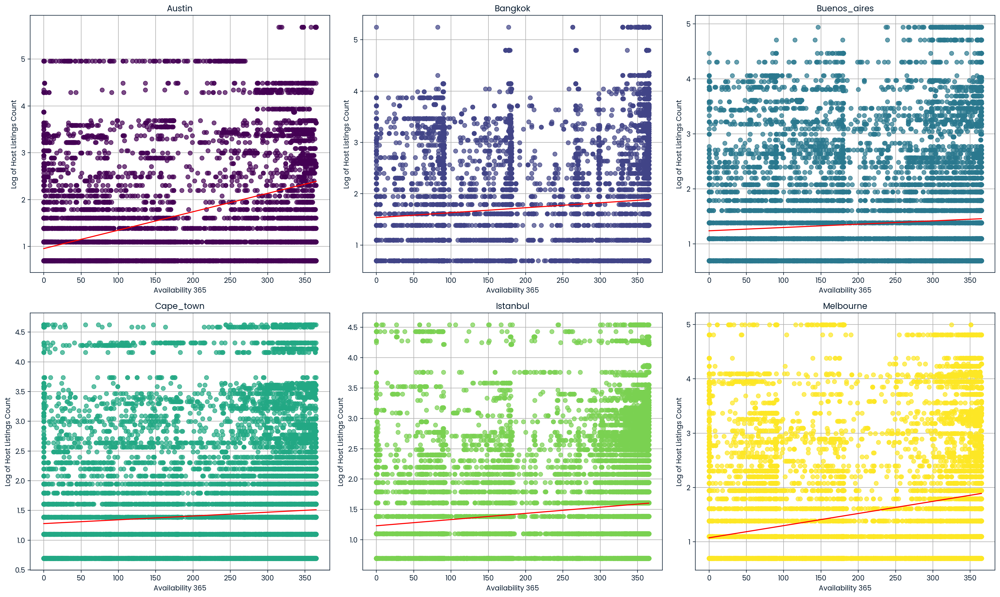

In [28]:

# Define a linear function for curve fitting
def linear_func(x, a, b):
    return a * x + b

cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    
    # Taking the log of the y variable
    y_log = np.log(subset["calculated_host_listings_count"] + 1)  # Adding 1 to avoid log(0)
    
    # Plotting the original data with log transformation
    ax.scatter(subset["availability_365"], y_log, color=colors[i], alpha=0.7, zorder=2)
    
    # Perform curve fitting on the log-transformed data
    popt, pcov = curve_fit(linear_func, subset["availability_365"], y_log)
    
    # Generate x values for the fitted line
    x_fit = np.linspace(subset["availability_365"].min(), subset["availability_365"].max(), 100)
    # Generate y values for the fitted line using the fitted parameters
    y_fit = linear_func(x_fit, *popt)
    
    # Plot the fitted line
    ax.plot(x_fit, y_fit, '-', color='red')
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.set_ylabel('Log of Host Listings Count')
    ax.grid(True, zorder=1)

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# Reviews Per Month vs Availability

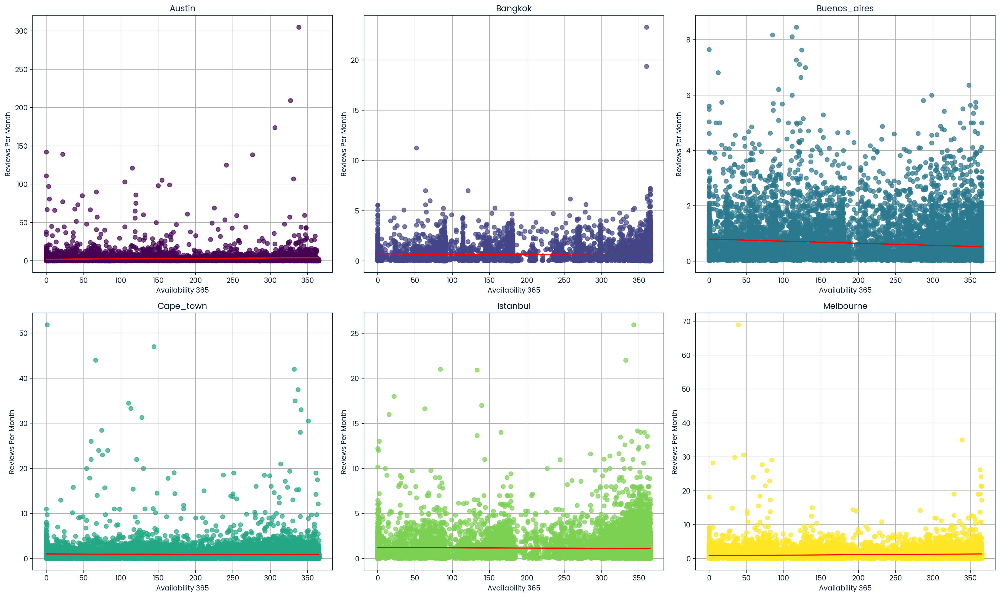

In [44]:

def linear_fit(x, a, b):
    return a * x + b

cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    x = subset["availability_365"]
    y = subset["reviews_per_month"]
    
    # Fit a linear model
    popt, _ = curve_fit(linear_fit, x, y)
    
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    ax.plot(x, y, 'o', color=colors[i], alpha=0.7, zorder=2)  # Dot plot for each city
    ax.plot(x, linear_fit(x, *popt), '-', color='red')  # Line of best fit
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.set_ylabel('Reviews Per Month')
    ax.grid(True, zorder=1)

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# Reviews Per Month vs Availability - Log

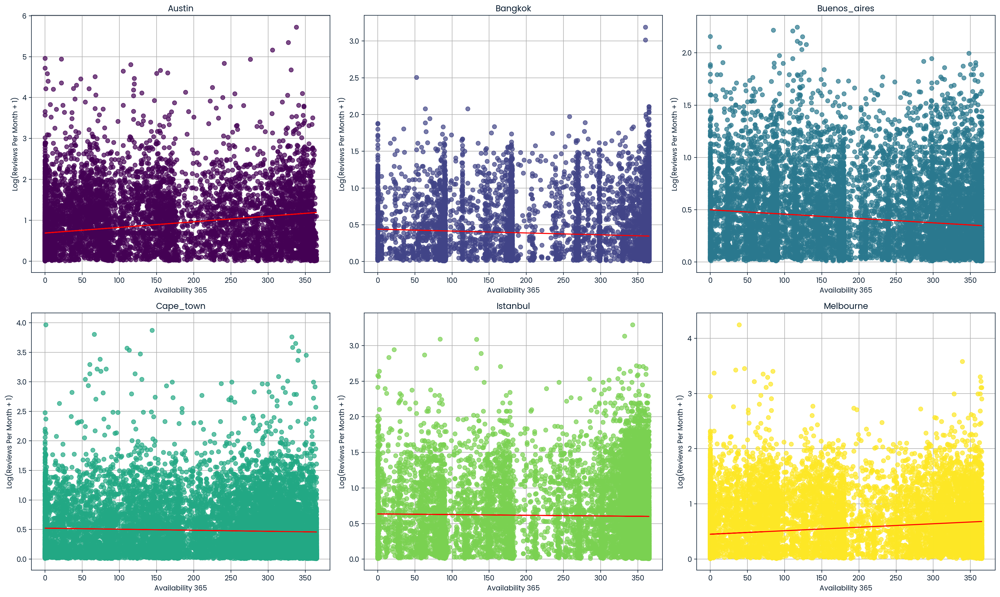

In [49]:


def linear_fit(x, a, b):
    return a * x + b

cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    x = subset["availability_365"]
    y = subset["reviews_per_month"]
    
    # Taking log of y to fit a linear model on transformed data
    y_log = np.log(y + 1)  # Adding 1 to avoid log(0)
    
    # Fit a linear model on log-transformed y
    popt, _ = curve_fit(linear_fit, x, y_log)
    
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    ax.plot(x, y_log, 'o', color=colors[i], alpha=0.7, zorder=2)  # Dot plot for each city
    ax.plot(x, linear_fit(x, *popt), '-', color='red')  # Line of best fit on log-transformed y
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.set_ylabel('Log(Reviews Per Month + 1)')
    ax.grid(True, zorder=1)

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

We will explore the distribution of availability_365 accross different cities.

<Figure size 5000x1000 with 0 Axes>

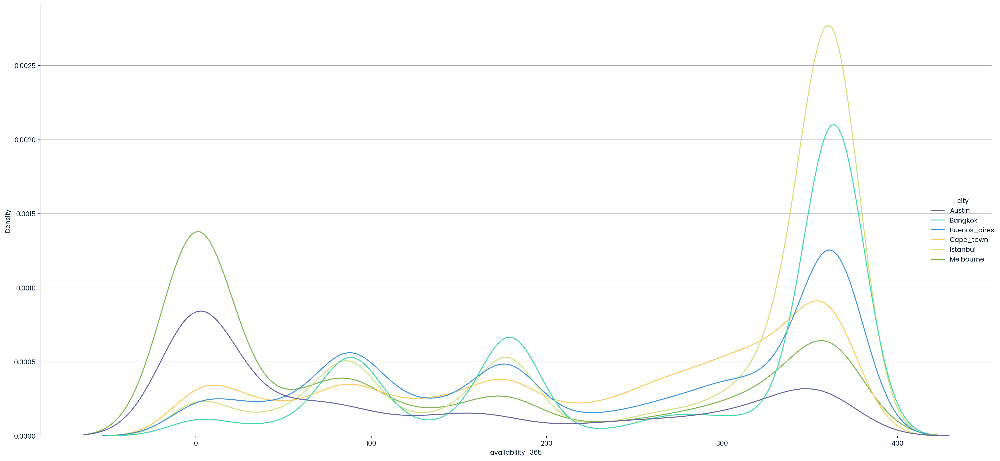

In [30]:
plt.figure(figsize=(50, 10))  # Increasing figure width for better horizontal stretch
sns.displot(listings, x="availability_365", hue="city", kind='kde', height=10, aspect=2, zorder=2)  # Adjusting aspect for wider display
plt.tight_layout()
plt.grid(axis='y', zorder=1)
plt.show()

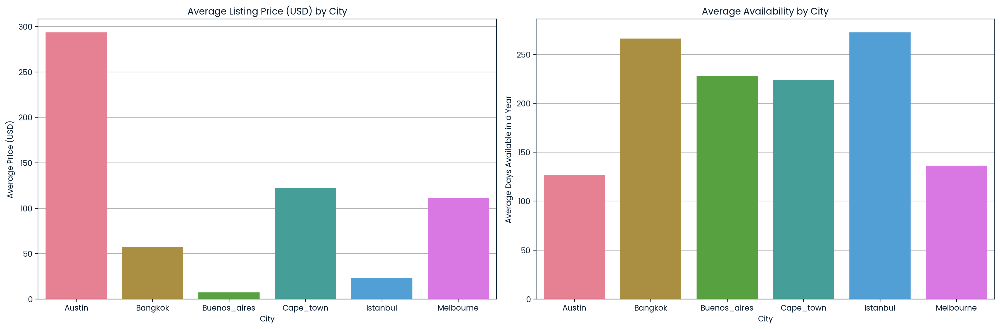

In [31]:
# Compute average price and availability per city
avg_price_availability = listings.groupby('city').agg(
    average_price=('price_USD', 'mean'),
    average_availability_365=('availability_365', 'mean')
).reset_index()

# Plotting the data
fig, ax = plt.subplots(1, 2, figsize=(18, 6))

# Average Price by City
sns.barplot(x='city', y='average_price', data=avg_price_availability, ax=ax[0], palette='husl', zorder=2)
ax[0].set_title('Average Listing Price (USD) by City')
ax[0].set_ylabel('Average Price (USD)')
ax[0].set_xlabel('City')
ax[0].grid(axis='y', zorder=1)

# Average Availability by City
sns.barplot(x='city', y='average_availability_365', data=avg_price_availability, ax=ax[1], palette='husl', zorder=2)
ax[1].set_title('Average Availability by City')
ax[1].set_ylabel('Average Days Available in a Year')
ax[1].set_xlabel('City')
ax[1].grid(axis='y', zorder=1)

plt.tight_layout()
plt.show()

# Number of Listings vs Availability 365 

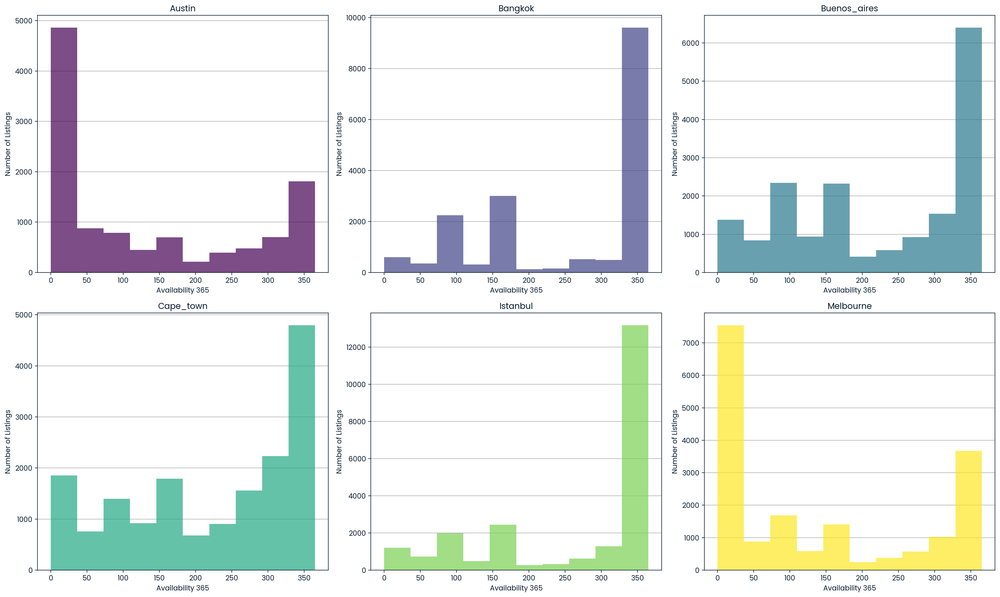

In [32]:
cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    ax.hist(subset["availability_365"], alpha=0.7, color=colors[i], zorder=2)  # Histogram for each city
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.grid(axis='y', zorder=1)
    ax.set_ylabel('Number of Listings')

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

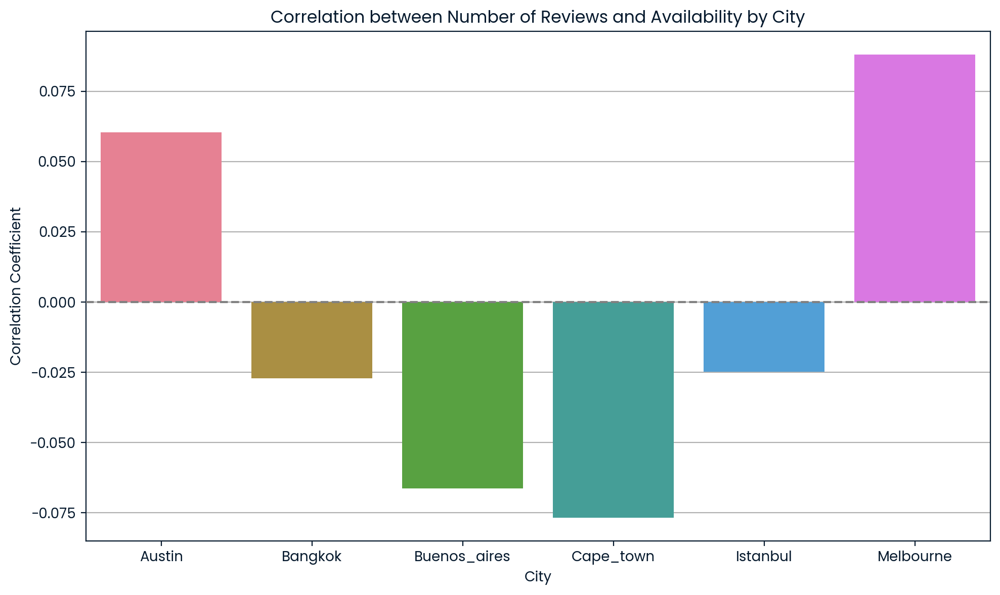

In [33]:
# Calculate correlation for each city
correlations = []
for city in listings['city'].unique():
    city_data = listings[listings['city'] == city]
    correlation = city_data[['number_of_reviews', 'availability_365']].corr().iloc[0, 1]
    correlations.append({'city': city, 'correlation': correlation})

# Convert list to DataFrame
correlation_df = pd.DataFrame(correlations)

# Plotting the bar chart
plt.figure(figsize=(10, 6))
sns.barplot(data=correlation_df, x='city', y='correlation', palette='husl', zorder=2)
plt.title('Correlation between Number of Reviews and Availability by City')
plt.xlabel('City')
plt.ylabel('Correlation Coefficient')
plt.grid(axis='y', zorder=1)
plt.tight_layout()
plt.axhline(0, color='gray', linestyle='--', zorder=3)
plt.show()

 From this distribution we can see that...

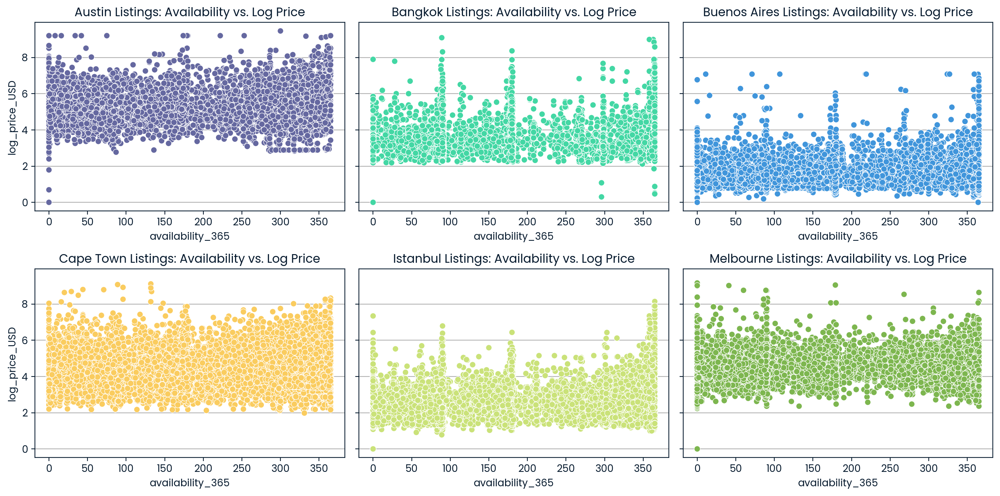

In [35]:
#sns.scatterplot(data=listings, x="availability_365", y=np.log1p(listings["price_USD"]), hue="city")
#sns.scatterplot(data=austin_listings, x="availability_365", y="log_price_USD", hue="city", legend=False)

# Set up the matplotlib figure with two subplots, sharing the same y-axis
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(14, 7), sharey=True)

# Filter for Austin listings first
austin_listings = listings.loc[listings['city'] == 'Austin'].copy()
austin_listings['log_price_USD'] = np.log1p(austin_listings['price_USD'])

sns.scatterplot(ax=axes[0,0], data=austin_listings, x="availability_365", y="log_price_USD", hue="city", legend=False, zorder=2)
axes[0,0].set_title('Austin Listings: Availability vs. Log Price')
axes[0,0].grid(axis='y', zorder=1)

# Filter for Bangkok listings second
bangkok_listings = listings.loc[listings['city'] == 'Bangkok'].copy()
bangkok_listings['log_price_USD'] = np.log1p(bangkok_listings['price_USD'])

sns.scatterplot(ax=axes[0,1], data=bangkok_listings, x="availability_365", y="log_price_USD", hue="city", legend=False, zorder=2)
axes[0,1].set_title('Bangkok Listings: Availability vs. Log Price')
axes[0,1].grid(axis='y', zorder=1)

# Filter for Buenos_aires listings third
buenos_aires_listings = listings.loc[listings['city'] == 'Buenos_aires'].copy()
buenos_aires_listings['log_price_USD'] = np.log1p(buenos_aires_listings['price_USD'])

sns.scatterplot(ax=axes[0,2], data=buenos_aires_listings, x="availability_365", y="log_price_USD", hue="city", legend=False, zorder=2)
axes[0,2].set_title('Buenos Aires Listings: Availability vs. Log Price')
axes[0,2].grid(axis='y', zorder=1)

# Filter for Cape_town listings fourth
cape_town_listings = listings.loc[listings['city'] == 'Cape_town'].copy()
cape_town_listings['log_price_USD'] = np.log1p(cape_town_listings['price_USD'])

sns.scatterplot(ax=axes[1,0], data=cape_town_listings, x="availability_365", y="log_price_USD", hue="city", legend=False, zorder=2)
axes[1,0].set_title('Cape Town Listings: Availability vs. Log Price')
axes[1,0].grid(axis='y', zorder=1)

# Filter for Istanbul listings fifth
istanbul_listings = listings.loc[listings['city'] == 'Istanbul'].copy()
istanbul_listings['log_price_USD'] = np.log1p(istanbul_listings['price_USD'])

sns.scatterplot(ax=axes[1,1], data=istanbul_listings, x="availability_365", y="log_price_USD", hue="city", legend=False, zorder=2)
axes[1,1].set_title('Istanbul Listings: Availability vs. Log Price')
axes[1,1].grid(axis='y', zorder=1)


# Filter for Melbourne listings sixth
melbourne_listings = listings.loc[listings['city'] == 'Melbourne'].copy()
melbourne_listings['log_price_USD'] = np.log1p(melbourne_listings['price_USD'])

sns.scatterplot(ax=axes[1,2], data=melbourne_listings, x="availability_365", y="log_price_USD", hue="city", legend=False, zorder=2)
axes[1,2].set_title('Melbourne Listings: Availability vs. Log Price')
axes[1,2].grid(axis='y', zorder=1)

# Display the plots
plt.tight_layout()
plt.show()


# Model 1 - Multiple Linear Regression

pairgrid 
univariate distribution between cities

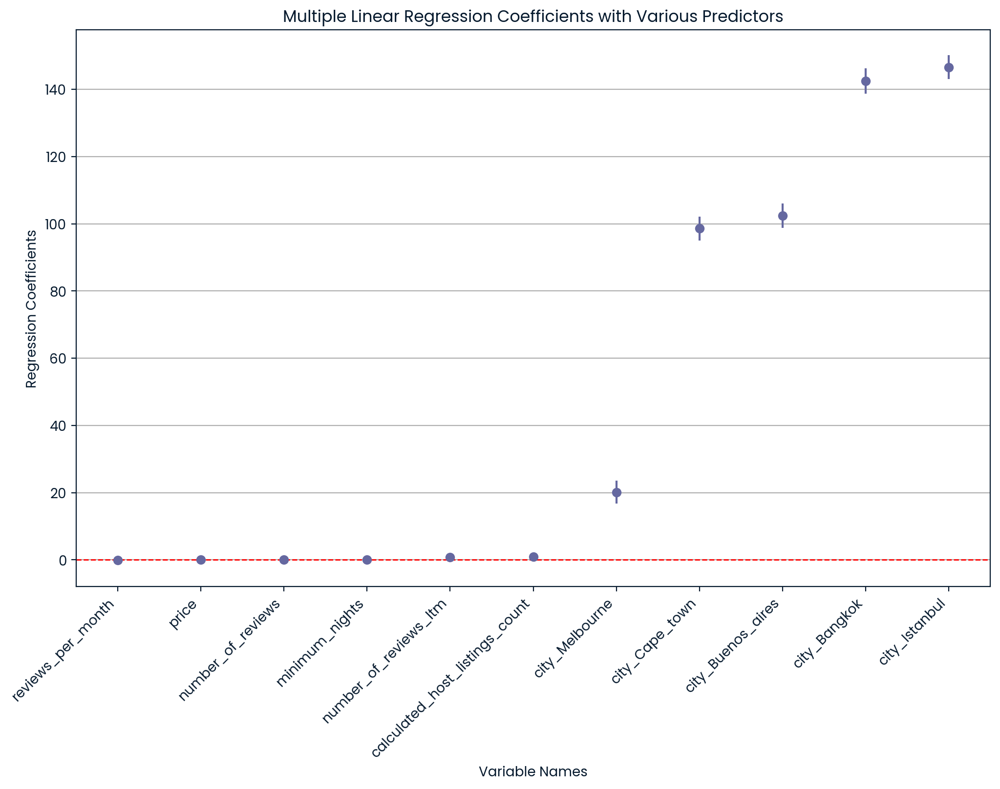

In [36]:
from sklearn.preprocessing import OneHotEncoder

# Assuming listings is already loaded and prepared

# One-hot encode the 'city' column
encoder = OneHotEncoder(drop='first', sparse=False)
city_encoded = encoder.fit_transform(listings[['city']])
city_encoded_df = pd.DataFrame(city_encoded, columns=encoder.get_feature_names_out(['city']))

# Reset the index on both the original and encoded DataFrames to ensure alignment
listings.reset_index(drop=True, inplace=True)
city_encoded_df.reset_index(drop=True, inplace=True)

# Now create the mask for rows with any missing values in the cleaned listings DataFrame
missing_rows = listings.isnull().any(axis=1)

# Apply the missing data mask to both DataFrames
listings_cleaned = listings.loc[~missing_rows]
city_encoded_cleaned = city_encoded_df.loc[~missing_rows]

# Concatenate the cleaned and encoded DataFrames
listings_encoded = pd.concat([listings_cleaned.drop(columns=['city']), city_encoded_cleaned], axis=1)

# Define predictors including the new city columns
predictors = ['price', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 
              'calculated_host_listings_count', 'number_of_reviews_ltm'] + list(city_encoded_cleaned.columns)

# Define the independent variables (X) and the dependent variable (y)
X = listings_encoded.loc[:, predictors]
y = listings_encoded['availability_365']

# Add a constant to the model (intercept)
X = sm.add_constant(X)

# Fit the model
model = sm.OLS(y, X).fit()

# Get the summary of the regression
summary = model.summary()

# Extracting the parameters from the model excluding the intercept
params = model.params[1:]  # Exclude the intercept
conf = model.conf_int().loc[predictors]  # Get confidence interval for predictors
conf['coef'] = params

# Plot
conf.columns = ['2.5%', '97.5%', 'coef']
conf = conf.sort_values('coef')

plt.figure(figsize=(10, 8))
plt.errorbar(conf.index, conf['coef'], yerr=[conf['coef'] - conf['2.5%'], conf['97.5%'] - conf['coef']], fmt='o', zorder=3)
plt.title('Multiple Linear Regression Coefficients with Various Predictors')
plt.axhline(y=0, linestyle='--', color='red', linewidth=1, zorder=2)
plt.xticks(rotation=45)  # Rotate labels to avoid overlap
plt.tight_layout()
plt.ylabel('Regression Coefficients')
plt.xlabel('Variable Names')
plt.grid(axis='y', zorder=1)

labels = plt.gca().get_xticklabels()
for label in labels:
    label.set_horizontalalignment('right')

plt.show()

## Price Prediction

A root mean squared error of 4.18 means that, on average, the model predicts values approximately 4.18 units away from the target value, which is not bad in terms of accuracy. Since the median value (from 1980) is in the thousands, the predictions are about $4,180 off.

A root mean squared error of 4.18 means that, on average, the model predicts values approximately 4.18 units away from the target value, which is not bad in terms of accuracy. Since the median value (from 1980) is in the thousands, the predictions are about $4,180 off.

In [37]:
listings['available'] = listings['availability_365'].apply(lambda x: 0 if x == 0 else 1)
listings

,city,id,name,host_id,host_name,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,price_USD,available
0,Austin,2265,Zen-East in the Heart of Austin (monthly rental),2466,Paddy,Entire home/apt,179,7,26,0.36,3,35,2,179.00,1
1,Austin,5245,"Eco friendly, Colorful, Clean, Cozy monthly share",2466,Paddy,Private room,114,30,9,0.21,3,0,0,114.00,0
2,Austin,5456,"Walk to 6th, Rainey St and Convention Ctr",8028,Sylvia,Entire home/apt,108,2,575,24.16,1,324,39,108.00,1
3,Austin,5769,NW Austin Room,8186,Elizabeth,Private room,39,1,264,5.95,1,0,7,39.00,0
4,Austin,6413,Gem of a Studio near Downtown,13879,Todd,Entire home/apt,109,3,117,1.27,1,0,4,109.00,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103812,Melbourne,53173707,A Stylish & Central Apt with Beautiful City Views,343442154,Advante Homes,Entire home/apt,72,1,0,NaN,79,346,0,46.08,1
103813,Melbourne,53174106,Cheerful 4 Bedroom modern house.,430458694,Mekail,Entire home/apt,360,1,0,NaN,1,355,0,230.40,1
103814,Melbourne,53175067,1 ensuite in a 2 bedroom apartment close to CBD,38148099,Vinall,Private room,60,28,0,NaN,1,83,0,38.40,1
103815,Melbourne,53176412,Harbour Esplanade Docklands Residences,344833735,Kelwin,Entire home/apt,120,1,0,NaN,3,87,0,76.80,1


In [38]:
from sklearn.model_selection import cross_val_score
# drop null values
listings = listings.dropna()

# listings.head() - assuming listings is a DataFrame
# declare X and y
X = listings.iloc[:,[7, 8, 9, 10, 11, 12]].values # min nights, # of reviews, #reviews
y = listings.iloc[:, 13].values # Price


#Create training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)
#Create the regressor: reg
reg = LinearRegression()
#Fit the regressor to the training data
reg.fit(X_train, y_train)
# Predict on the test data: y_pred
y_pred = reg.predict(X_test)
# Compute and print RMSE
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("Root Mean Squared Error: {}".format(rmse))

Root Mean Squared Error: 242.2491221434098


In [39]:
#Define the regression_model_cv function, which takes a fitted model as one parameter. 
# The k = 5 hyperparameter gives the number of folds.
def regression_model_cv(model, k=5):
    scores = cross_val_score(model, X, y, scoring='neg_mean_squared_error', cv=k)
    rmse = np.sqrt(-scores)
    print('Reg rmse:', rmse)
    print('Reg mean:', rmse.mean ())
    
# k = 8 is the best fit gives RME of 203
regression_model_cv(LinearRegression(), k=8)

'''
from sklearn.linear_model import Ridge
regression_model_cv(Ridge())

from sklearn.linear_model import Lasso 
regression_model_cv(Lasso())

from sklearn.model_selection import GridSearchCV
# Ridge Gives 248 which is worse so no overfitting?
#hyperparameter tuning
grid = dict()
grid['alpha'] = np.arange(0.01, 500, .1)
n_folds=5
# define search
search = GridSearchCV(Lasso(), grid, scoring='neg_mean_squared_error', cv=n_folds, n_jobs=-1)
# perform the search
results = search.fit(X, y)
#output results for best fit
k = search.best_params_
print("Best alpha: {}".format(k))
score = search.best_score_
rsm = np.sqrt(-score)
print("Best score: {}".format(rsm))
'''

Reg rmse: [563.97450761 166.98926184  94.6880381  130.81871539 178.53260746
  85.39121159 191.33367542 209.63421852]
Reg mean: 202.67027949256203


'\nfrom sklearn.linear_model import Ridge\nregression_model_cv(Ridge())\n\nfrom sklearn.linear_model import Lasso \nregression_model_cv(Lasso())\n\nfrom sklearn.model_selection import GridSearchCV\n# Ridge Gives 248 which is worse so no overfitting?\n#hyperparameter tuning\ngrid = dict()\ngrid[\'alpha\'] = np.arange(0.01, 500, .1)\nn_folds=5\n# define search\nsearch = GridSearchCV(Lasso(), grid, scoring=\'neg_mean_squared_error\', cv=n_folds, n_jobs=-1)\n# perform the search\nresults = search.fit(X, y)\n#output results for best fit\nk = search.best_params_\nprint("Best alpha: {}".format(k))\nscore = search.best_score_\nrsm = np.sqrt(-score)\nprint("Best score: {}".format(rsm))\n'

In [40]:
from sklearn.neighbors import KNeighborsRegressor
regression_model_cv(KNeighborsRegressor(n_neighbors=4))
regression_model_cv(KNeighborsRegressor(n_neighbors=7))
regression_model_cv(KNeighborsRegressor(n_neighbors=10))

'''
from sklearn.model_selection import GridSearchCV
neighbors = np.linspace(1, 20, 20)
k = neighbors.astype(int)
param_grid = {'n_neighbors': k}
knn = KNeighborsRegressor()
knn_tuned = GridSearchCV(knn, param_grid, cv=5, scoring='neg_mean_squared_error')
knn_tuned.fit(X, y)
k = knn_tuned.best_params_
print("Best n_neighbors: {}".format(k))
score = knn_tuned.best_score_
rsm = np.sqrt(-score)
print("Best score: {}".format(rsm))
'''

Reg rmse: [462.49985487 171.71956448 219.79129818 170.44665496 285.27903017]
Reg mean: 261.9472805326879
Reg rmse: [461.77225957 146.73889672 203.20137547 151.92308444 261.3782341 ]
Reg mean: 245.002770058017
Reg rmse: [460.84169133 138.54601071 194.77789055 143.24180348 253.29666084]
Reg mean: 238.14081137974375


'\nfrom sklearn.model_selection import GridSearchCV\nneighbors = np.linspace(1, 20, 20)\nk = neighbors.astype(int)\nparam_grid = {\'n_neighbors\': k}\nknn = KNeighborsRegressor()\nknn_tuned = GridSearchCV(knn, param_grid, cv=5, scoring=\'neg_mean_squared_error\')\nknn_tuned.fit(X, y)\nk = knn_tuned.best_params_\nprint("Best n_neighbors: {}".format(k))\nscore = knn_tuned.best_score_\nrsm = np.sqrt(-score)\nprint("Best score: {}".format(rsm))\n'

In [197]:
from sklearn import tree
regression_model_cv(tree.DecisionTreeRegressor())

from sklearn.ensemble import RandomForestRegressor
regression_model_cv(RandomForestRegressor())

regression_model_cv(RandomForestRegressor(n_jobs=-1, n_estimators=100))
regression_model_cv(RandomForestRegressor(n_jobs=-1, n_estimators=10, min_samples_split=4, min_samples_leaf=2 ))
from sklearn.model_selection import RandomizedSearchCV
'''
param_grid = {'max_depth': [None, 10, 30, 50, 70, 100, 200, 400],
             'min_samples_split': [2, 3, 4, 5],
             'min_samples_leaf': [1, 2, 3],
             'max_features': ['sqrt', 'log2']}
reg = RandomForestRegressor(n_jobs = -1)
reg_tuned = RandomizedSearchCV(reg, param_grid, cv=5, scoring='neg_mean_squared_error')
reg_tuned.fit(X, y)
p = reg_tuned.best_params_
print("Best tuned params: {}".format(p))
score = reg_tuned.best_score_
rsm = np.sqrt(-score)
print("Best score: {}".format(rsm))
# Setup the hyperparameter grid
regression_model_cv(RandomForestRegressor(n_jobs=-1, n_estimators=100))
'''

Reg rmse: [493.39766353 365.6288324  387.03336885 296.63041817 339.73720907]
Reg mean: 376.48549840185063


KeyboardInterrupt: 

## Availibilty 

normalize data, scale values, min max, z score norminlization, 

In [246]:
from sklearn.model_selection import cross_val_score
# drop null values
listingz_norm = listingz.dropna()
listings = listings.dropna()
# listings.head() - assuming listings is a DataFrame
# declare X and y
X = listingz[['minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'number_of_reviews_ltm', 'price_USD']]
y = listings['availability_365'] # Availibility 
#X = listings_norm.iloc[:,[7,8,9,10,12,13]].values # min nights, # of reviews, #reviews
#X = listings[['minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'number_of_reviews_ltm', 'price_USD']]
#y = listings.iloc[:, 11].values # Availibility 
#y = listings['available']
#y = listings['availability_365']



#Create training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)
#Create the regressor: reg
reg = LinearRegression()
#Fit the regressor to the training data
reg.fit(X_train, y_train)
# Predict on the test data: y_pred
y_pred = reg.predict(X_test)
# Compute and print RMSE
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("Root Mean Squared Error: {}".format(rmse))

ValueError: Found input variables with inconsistent numbers of samples: [103817, 68906]

In [199]:
#Define the regression_model_cv function, which takes a fitted model as one parameter. 
# The k = 5 hyperparameter gives the number of folds.
def regression_model_cv(model, k=5):
    scores = cross_val_score(model, X, y, scoring='neg_mean_squared_error', cv=k)
    rmse = np.sqrt(-scores)
    print('Reg rmse:', rmse)
    print('Reg mean:', rmse.mean ())
    
# k = 8 is the best fit gives RME of 203
regression_model_cv(LinearRegression(), k=3) # 138


from sklearn.linear_model import Ridge
regression_model_cv(Ridge())

from sklearn.linear_model import Lasso 
regression_model_cv(Lasso())
'''
# Ridge = 140.44
from sklearn.model_selection import GridSearchCV
# Ridge Gives 248 which is worse so no overfitting?
#hyperparameter tuning
grid = dict()
grid['alpha'] = np.arange(0.01, 500, .1)
n_folds=5
# define search
search = GridSearchCV(Ridge(), grid, scoring='neg_mean_squared_error', cv=n_folds, n_jobs=-1)
# perform the search
results = search.fit(X, y)
#output results for best fit
k = search.best_params_
print("Best alpha: {}".format(k))
score = search.best_score_
rsm = np.sqrt(-score)
print("Best score: {}".format(rsm))
'''

Reg rmse: [139.93535156 125.2489999  149.18201384]
Reg mean: 138.12212176943902
Reg rmse: [146.65842182 127.14172944 122.02475557 139.28121985 163.27445125]
Reg mean: 139.6761155845697
Reg rmse: [146.74864431 127.13639873 122.02001398 139.25553336 163.26297089]
Reg mean: 139.68471225579492


'\n# Ridge = 140.44\nfrom sklearn.model_selection import GridSearchCV\n# Ridge Gives 248 which is worse so no overfitting?\n#hyperparameter tuning\ngrid = dict()\ngrid[\'alpha\'] = np.arange(0.01, 500, .1)\nn_folds=5\n# define search\nsearch = GridSearchCV(Ridge(), grid, scoring=\'neg_mean_squared_error\', cv=n_folds, n_jobs=-1)\n# perform the search\nresults = search.fit(X, y)\n#output results for best fit\nk = search.best_params_\nprint("Best alpha: {}".format(k))\nscore = search.best_score_\nrsm = np.sqrt(-score)\nprint("Best score: {}".format(rsm))\n'

In [81]:
from sklearn.neighbors import KNeighborsRegressor
regression_model_cv(KNeighborsRegressor(n_neighbors=4))
regression_model_cv(KNeighborsRegressor(n_neighbors=7))
regression_model_cv(KNeighborsRegressor(n_neighbors=10))

#Best n = 20 score = 140.79
from sklearn.model_selection import GridSearchCV
neighbors = np.linspace(1, 20, 20)
k = neighbors.astype(int)
param_grid = {'n_neighbors': k}
knn = KNeighborsRegressor()
knn_tuned = GridSearchCV(knn, param_grid, cv=5, scoring='neg_mean_squared_error')
knn_tuned.fit(X, y)
k = knn_tuned.best_params_
print("Best n_neighbors: {}".format(k))
score = knn_tuned.best_score_
rsm = np.sqrt(-score)
print("Best score: {}".format(rsm))


Reg rmse: [153.4298195  143.90842299 151.30011603 140.45139919 167.1094101 ]
Reg mean: 151.23983356204434
Reg rmse: [147.94046239 137.79319829 145.62722262 134.67763281 162.27591294]
Reg mean: 145.66288581038037
Reg rmse: [145.76469532 135.0681102  143.36132413 132.82130059 160.00434188]
Reg mean: 143.40395442638828


KeyboardInterrupt: 

In [92]:
from sklearn import tree
regression_model_cv(tree.DecisionTreeRegressor())

from sklearn.ensemble import RandomForestRegressor
regression_model_cv(RandomForestRegressor(n_jobs=-1, n_estimators=100))

from sklearn.model_selection import RandomizedSearchCV

param_grid = {'max_depth': [None, 10, 30, 50, 70, 100, 200, 400],
             'min_samples_split': [2, 3, 4, 5],
             'min_samples_leaf': [1, 2, 3],
             'max_features': ['sqrt', 'log2']}
reg = RandomForestRegressor(n_jobs = -1)
reg_tuned = RandomizedSearchCV(reg, param_grid, cv=5, scoring='neg_mean_squared_error')
reg_tuned.fit(X, y)
p = reg_tuned.best_params_
print("Best tuned params: {}".format(p))
score = reg_tuned.best_score_
rsm = np.sqrt(-score)
print("Best score: {}".format(rsm))
# Setup the hyperparameter grid
regression_model_cv(RandomForestRegressor(n_jobs=-1, n_estimators=100))

Reg rmse: [184.93020149 175.37624786 183.59046351 178.46082326 199.98665464]
Reg mean: 184.46887814919182
Reg rmse: [142.11924643 130.53407839 137.15746721 132.23897268 158.83847369]
Reg mean: 140.17764768029966
Best tuned params: {'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features': 'sqrt', 'max_depth': 100}
Best score: 136.89847836515258
Reg rmse: [142.16253625 130.7251025  136.99693586 132.05263911 158.7963832 ]
Reg mean: 140.14671938249617


## Logistic Regression

In [46]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score

# Assuming 'listings' dataframe is already defined and includes the 'city' column
cities = listings['city'].unique()

def clf_model_per_city(model, X, y, city_name):
    clf = model
    scores = cross_val_score(clf, X, y)
    print(f'City: {city_name}')
    print('Scores:', scores)
    print('Mean score:', scores.mean())
    print('---' * 10)

for city in cities:
    city_listings = listings[listings['city'] == city]
    X_city = city_listings.iloc[:, [7,8,9,10,12,13]]
    y_city = city_listings.iloc[:, -1]
    clf_model_per_city(LogisticRegression(max_iter=1000), X_city, y_city, city)

City: Austin
Scores: [0.76274165 0.88927944 0.86760398 0.89976553 0.66764361]
Mean score: 0.8174068434849675
------------------------------
City: Bangkok
Scores: [0.97433414 0.97384988 0.9748062  0.9748062  0.9748062 ]
Mean score: 0.9745205248043245
------------------------------
City: Buenos_aires
Scores: [0.96155436 0.96155436 0.96195203 0.96195203 0.96195203]
Mean score: 0.9617929604034232
------------------------------
City: Cape_town
Scores: [0.95173267 0.95212546 0.95212546 0.95212546 0.95171275]
Mean score: 0.9519643637908981
------------------------------
City: Istanbul
Scores: [0.96810273 0.96810273 0.96810273 0.96768848 0.96768848]
Mean score: 0.9679370339685169
------------------------------
City: Melbourne
Scores: [0.64246824 0.76261343 0.75136116 0.73238925 0.81989833]
Mean score: 0.7417460825830634
------------------------------


In [126]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score

# Assuming 'listings' dataframe is already defined and includes the 'city' column
cities = listings['city'].unique()

def clf_model_per_city(model, X, y, city_name):
    # Initialize the classifier
    clf = model
    # Perform cross-validation
    scores = cross_val_score(clf, X, y, cv=5)  # using 5-fold cross-validation
    print(f'City: {city_name}')
    print('Scores:', scores)
    print('Mean score:', scores.mean())
    print('---' * 10)

for city in cities:
    city_listings = listings[listings['city'] == city]
    # Assuming that the features are in columns [7, 8, 9, 10, 12, 13] and the target is the last column
    X_city = city_listings.iloc[:, [7, 8, 9, 10, 12, 13]]
    y_city = city_listings.iloc[:, -1]
    # Call the function with the Decision Tree model
    clf_model_per_city(DecisionTreeClassifier(), X_city, y_city, city)
    
    


City: Austin
Scores: [0.73462214 0.80023433 0.75864089 0.73798359 0.76201641]
Mean score: 0.7586994727592267
------------------------------
City: Bangkok
Scores: [0.9283293  0.9496368  0.94428295 0.95542636 0.92877907]
Mean score: 0.9412908947575878
------------------------------
City: Buenos_aires
Scores: [0.91897478 0.918148   0.92018197 0.91315136 0.92555831]
Mean score: 0.9192028847991722
------------------------------
City: Cape_town
Scores: [0.88118812 0.89475856 0.90383822 0.90301279 0.88567891]
Mean score: 0.8936953208321246
------------------------------
City: Istanbul
Scores: [0.87365369 0.92667771 0.92833471 0.92336371 0.94283347]
Mean score: 0.9189726594863299
------------------------------
City: Melbourne
Scores: [0.68275862 0.70490018 0.68965517 0.62127814 0.70697168]
Mean score: 0.6811127586075096
------------------------------


In [134]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler

# Assuming 'listings' dataframe is already defined and includes the 'city' column
cities = listings['city'].unique()

def clf_model_per_city(model, X, y, city_name):
    # Initialize the classifier
    clf = model
    # Perform cross-validation
    scores = cross_val_score(clf, X, y, cv=5)  # using 5-fold cross-validation
    print(f'City: {city_name}')
    print('Scores:', scores)
    print('Mean score:', scores.mean())
    print('---' * 10)

# Initialize the StandardScaler
scaler = StandardScaler()

for city in cities:
    city_listings = listings[listings['city'] == city]
    # Assuming that the features are in columns [7, 8, 9, 10, 12, 13] and the target is the last column
    X_city = city_listings.iloc[:, [7, 8, 9, 10, 12, 13]]
    y_city = city_listings.iloc[:, -1]
    # Scale the features
    X_city_scaled = scaler.fit_transform(X_city)
    # Call the function with the Decision Tree model
    clf_model_per_city(DecisionTreeClassifier(), X_city_scaled, y_city, city)

City: Austin
Scores: [0.72876391 0.80082015 0.76274165 0.74032825 0.75908558]
Mean score: 0.7583479102323993
------------------------------
City: Bangkok
Scores: [0.9157385  0.95254237 0.94379845 0.95494186 0.92926357]
Mean score: 0.9392569495279389
------------------------------
City: Buenos_aires
Scores: [0.91856139 0.91690781 0.9210091  0.90984285 0.92638544]
Mean score: 0.9185413176838587
------------------------------
City: Cape_town
Scores: [0.88820132 0.89682212 0.89929839 0.89888568 0.88774247]
Mean score: 0.8941899957639181
------------------------------
City: Istanbul
Scores: [0.86951118 0.92916321 0.92916321 0.92212096 0.94117647]
Mean score: 0.9182270091135047
------------------------------
City: Melbourne
Scores: [0.69001815 0.70344828 0.69981851 0.62490922 0.69789397]
Mean score: 0.6832176263662687
------------------------------


In [203]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score

# Initialize the model with some options
random_forest_model = RandomForestRegressor(n_estimators=100, random_state=42)  # 100 trees in the forest

# Perform cross-validation
scores = cross_val_score(random_forest_model, X, y, scoring='neg_mean_squared_error', cv=5)
rmse_scores = np.sqrt(-scores)

print('Random Forest RMSE:', rmse_scores)
print('Average RMSE:', np.mean(rmse_scores))

KeyboardInterrupt: 

In [129]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import numpy as np

# Prepare the data
X = listings[['minimum_nights', 'number_of_reviews', 'reviews_per_month', 
              'calculated_host_listings_count', 'number_of_reviews_ltm', 'price_USD']]
y = listings['availability_365']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Decision Tree Regressor
decision_tree_regressor = DecisionTreeRegressor(random_state=42)

# Fit the model
decision_tree_regressor.fit(X_train, y_train)

# Predict on the test set
y_pred = decision_tree_regressor.predict(X_test)

# Calculate the RMSE
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

rmse

165.95994060712107

In [133]:
import pandas as pd

# Define a function to make predictions
def predict_availability(minimum_nights, number_of_reviews, reviews_per_month, 
                         calculated_host_listings_count, number_of_reviews_ltm, price_USD):
    # Create a DataFrame from the inputs (matching the same column order as during training)
    input_data = pd.DataFrame({
        'minimum_nights': [minimum_nights],
        'number_of_reviews': [number_of_reviews],
        'reviews_per_month': [reviews_per_month],
        'calculated_host_listings_count': [calculated_host_listings_count],
        'number_of_reviews_ltm': [number_of_reviews_ltm],
        'price_USD': [price_USD]
    })

    # Use the trained model to make a prediction
    predicted_availability = decision_tree_regressor.predict(input_data)
    
    # Output the prediction
    return predicted_availability[0]

# Example usage of the function
availability = predict_availability(3, 50, 2.5, 4, 20, 100)
print("Predicted availability for the next 365 days:", availability)

Predicted availability for the next 365 days: 172.0


Root Mean Square Error: 165.95994060712107


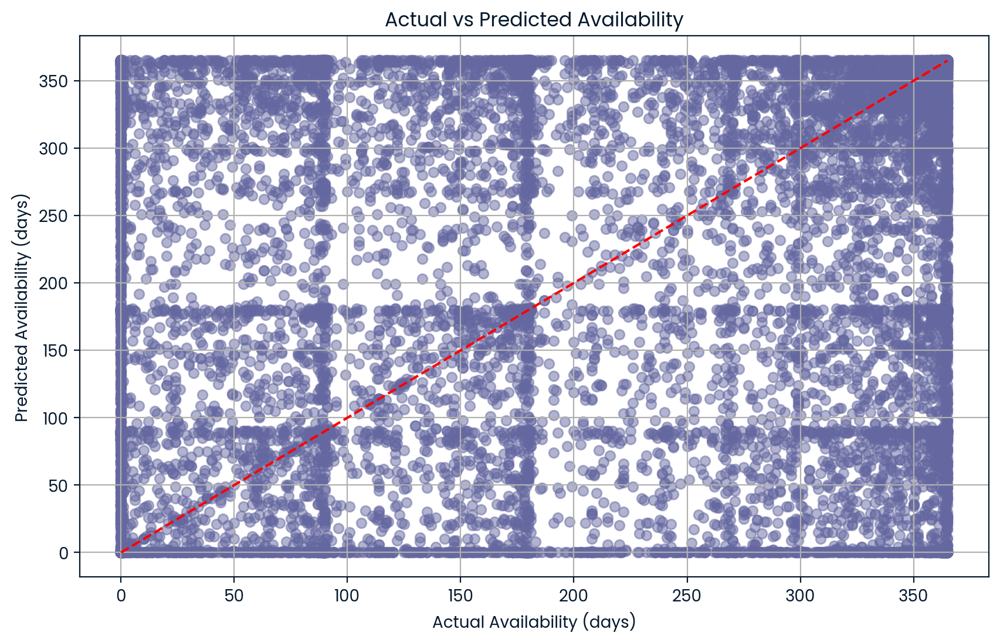

In [132]:
import matplotlib.pyplot as plt

# Predict on the test set
y_pred = decision_tree_regressor.predict(X_test)

# Calculate the RMSE
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("Root Mean Square Error:", rmse)

# Plotting actual vs predicted availability
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.5)
plt.title('Actual vs Predicted Availability')
plt.xlabel('Actual Availability (days)')
plt.ylabel('Predicted Availability (days)')
plt.plot([0, max(y_test.max(), y_pred.max())], [0, max(y_test.max(), y_pred.max())], 'r--')  # Diagonal line
plt.grid(True)
plt.show()

In [253]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import cross_val_score

# Initialize the model
gbm_model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)

# Evaluate the model
scores = cross_val_score(gbm_model, X, y, scoring='neg_mean_squared_error', cv=5)
rmse_scores = np.sqrt(-scores)

print('GBM RMSE:', rmse_scores)
print('Average RMSE:', np.mean(rmse_scores))

GBM RMSE: [461.53086585 126.99095637 168.90643257 114.71157523 259.36708388]
Average RMSE: 226.30138277910459


In [ ]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV
import numpy as np

# Initialize the model
gbm_model = GradientBoostingRegressor(random_state=42)

# Define the parameter grid
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Initialize the GridSearchCV object
grid_search = GridSearchCV(estimator=gbm_model, param_grid=param_grid, scoring='neg_mean_squared_error', cv=5, verbose=1, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X, y)

# Get the best estimator
best_gbm = grid_search.best_estimator_

# Print the best parameters and best score
print("Best parameters found: ", grid_search.best_params_)
print("Best cross-validation RMSE: ", np.sqrt(-grid_search.best_score_))

Fitting 5 folds for each of 243 candidates, totalling 1215 fits


KeyboardInterrupt: 

In [207]:
from sklearn.svm import SVR
from sklearn.model_selection import cross_val_score

# Initialize SVR with a simpler kernel or different parameters
svr_model = SVR(kernel='linear', C=1, epsilon=.1)

# Evaluate the model using parallel computation
scores = cross_val_score(svr_model, X, y, scoring='neg_mean_squared_error', cv=3, n_jobs=-1)
rmse_scores = np.sqrt(-scores)

print('SVR RMSE:', rmse_scores)
print('Average RMSE:', np.mean(rmse_scores))


KeyboardInterrupt: 

***Testing stuff below idk what's happin***

In [47]:
##### I'm testing some stuff based on what the TA suggested, idk if itll be any good
listings['interaction_host_listings_min_nights'] = listings.apply(lambda row: row['calculated_host_listings_count'] * row['minimum_nights'], axis=1)

listings['reviews_per_listing'] = listings.apply(lambda row: row['number_of_reviews'] / row['calculated_host_listings_count'] if row['calculated_host_listings_count'] > 0 else 0, axis=1)

listings['monthly_reviews_per_night_required'] = listings.apply(lambda row: row['reviews_per_month'] / row['minimum_nights'] if row['minimum_nights'] > 0 else 0, axis=1)

listings['activity_index'] = listings.apply(lambda row: (row['reviews_per_month'] * 0.5 + row['number_of_reviews_ltm'] * 0.5), axis=1)  # Example weights

listings['performance_score'] = listings.apply(lambda row: (row['number_of_reviews'] + row['reviews_per_month'] + row['number_of_reviews_ltm']) / 3, axis=1)

# Display the new columns to verify the results
listings

,city,id,name,host_id,host_name,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,price_USD,available,interaction_host_listings_min_nights,reviews_per_listing,monthly_reviews_per_night_required,activity_index,performance_score
0,Austin,2265,Zen-East in the Heart of Austin (monthly rental),2466,Paddy,Entire home/apt,179,7,26,0.36,3,35,2,179.00,1,21,8.666667,0.051429,1.180,9.453333
1,Austin,5245,"Eco friendly, Colorful, Clean, Cozy monthly share",2466,Paddy,Private room,114,30,9,0.21,3,0,0,114.00,0,90,3.000000,0.007000,0.105,3.070000
2,Austin,5456,"Walk to 6th, Rainey St and Convention Ctr",8028,Sylvia,Entire home/apt,108,2,575,24.16,1,324,39,108.00,1,2,575.000000,12.080000,31.580,212.720000
3,Austin,5769,NW Austin Room,8186,Elizabeth,Private room,39,1,264,5.95,1,0,7,39.00,0,1,264.000000,5.950000,6.475,92.316667
4,Austin,6413,Gem of a Studio near Downtown,13879,Todd,Entire home/apt,109,3,117,1.27,1,0,4,109.00,0,3,117.000000,0.423333,2.635,40.756667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103729,Melbourne,52980228,Eq tower-sky high view-free parking,254627785,Kathy,Entire home/apt,135,1,2,2.00,5,104,2,86.40,1,5,0.400000,2.000000,2.000,2.000000
103748,Melbourne,53015109,"Walk to Moonee Valley 2br, Free wifi, wine",9885145,Ali,Entire home/apt,130,2,1,1.00,5,315,1,83.20,1,10,0.200000,0.500000,1.000,1.000000
103751,Melbourne,53018544,【Amazing location】1-BEDROOM APARTMENT IN FREE ...,408511099,Qi,Entire home/apt,111,2,1,1.00,1,129,1,71.04,1,2,1.000000,0.500000,1.000,1.000000
103755,Melbourne,53020017,HeartCBD Highrise 2 bedrooms+parking by request,231393835,Renlei,Entire home/apt,101,1,1,1.00,5,348,1,64.64,1,5,0.200000,1.000000,1.000,1.000000


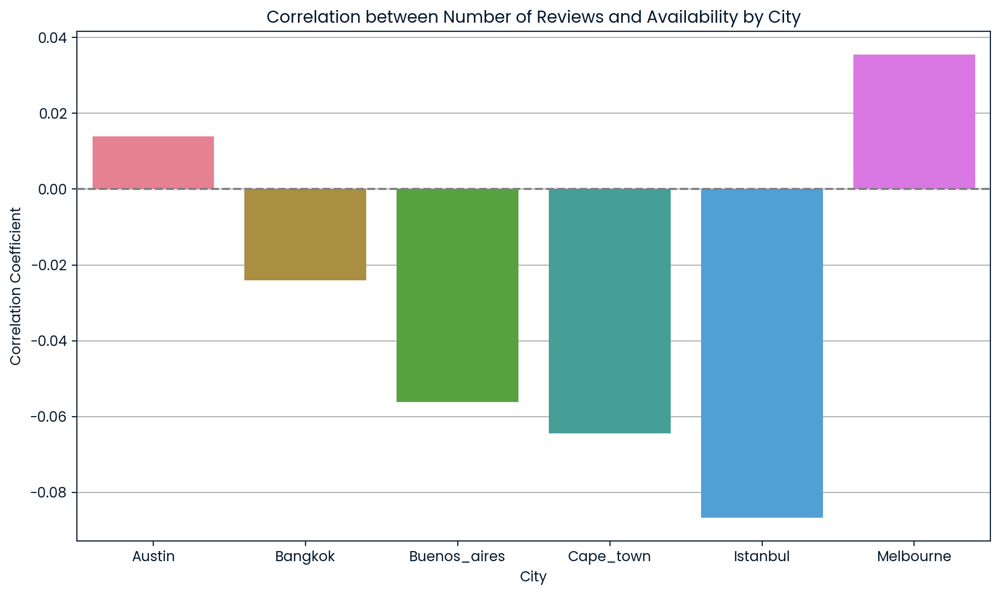

In [54]:
# Calculate correlation for each city
correlations = []
for city in listings['city'].unique():
    city_data = listings[listings['city'] == city]
    correlation = city_data[['reviews_per_listing', 'availability_365']].corr().iloc[0, 1]
    correlations.append({'city': city, 'correlation': correlation})

# Convert list to DataFrame
correlation_df = pd.DataFrame(correlations)

# Plotting the bar chart
plt.figure(figsize=(10, 6))
sns.barplot(data=correlation_df, x='city', y='correlation', palette='husl', zorder=2)
plt.title('Correlation between Number of Reviews and Availability by City')
plt.xlabel('City')
plt.ylabel('Correlation Coefficient')
plt.grid(axis='y', zorder=1)
plt.tight_layout()
plt.axhline(0, color='gray', linestyle='--', zorder=3)
plt.show()

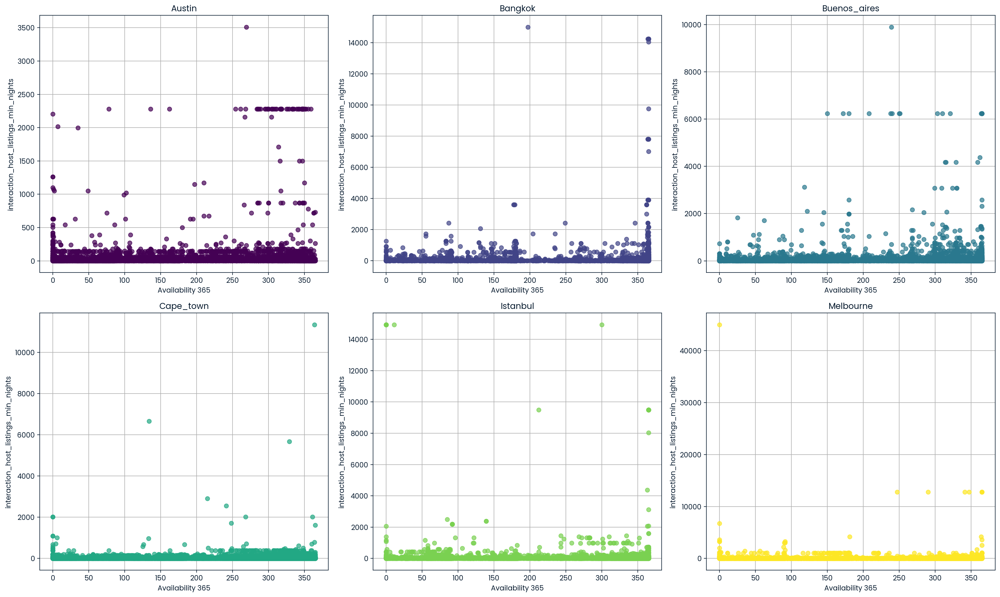

In [48]:
cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    ax.plot(subset["availability_365"], subset["interaction_host_listings_min_nights"], 'o', color=colors[i], alpha=0.7, zorder=2)  # Dot plot for each city
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.set_ylabel('interaction_host_listings_min_nights')
    ax.grid(True, zorder=1)


# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

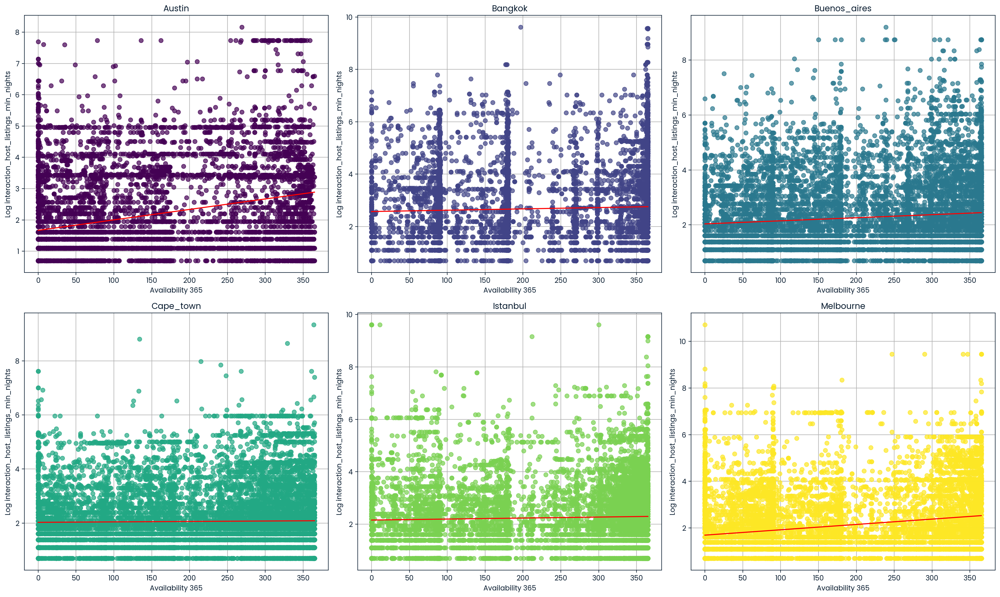

In [51]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

cities = listings['city'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(cities)))  # Generating a color map

# Calculate rows needed for 3 cities per row
rows = len(cities) // 3 + (1 if len(cities) % 3 else 0)

fig, axs = plt.subplots(rows, 3, figsize=(20, 6*rows))

for i, city in enumerate(cities):
    row = i // 3
    col = i % 3
    subset = listings[listings['city'] == city]
    if rows == 1:
        ax = axs[col]
    else:
        ax = axs[row, col]
    
    # Applying log transformation to price_USD to normalize distribution
    subset['log_interaction_host_listings_min_nights'] = np.log(subset['interaction_host_listings_min_nights'] + 1)  # Adding 1 to avoid log(0)
    
    # Plotting the scatter plot with log transformation
    ax.scatter(subset["availability_365"], subset["log_interaction_host_listings_min_nights"], color=colors[i], alpha=0.7, zorder=2)
    
    # Fitting a line of best fit on the log-transformed prices
    x = subset["availability_365"]
    y = subset["log_interaction_host_listings_min_nights"]
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
    x_new = np.linspace(x.min(), x.max(), num=200)
    y_new = intercept + slope * x_new
    
    ax.plot(x_new, y_new, color="red", zorder=3)
    
    ax.set_title(str(city))
    ax.set_xlabel('Availability 365')
    ax.grid(True, zorder=1)
    ax.set_ylabel('Log interaction_host_listings_min_nights')

# Hide empty subplots if cities count is not a multiple of 3
if len(cities) % 3:
    for idx in range(len(cities), rows * 3):
        row = idx // 3
        col = idx % 3
        if rows == 1:
            axs[col].axis('off')
        else:
            axs[row, col].axis('off')

plt.tight_layout()
plt.show()

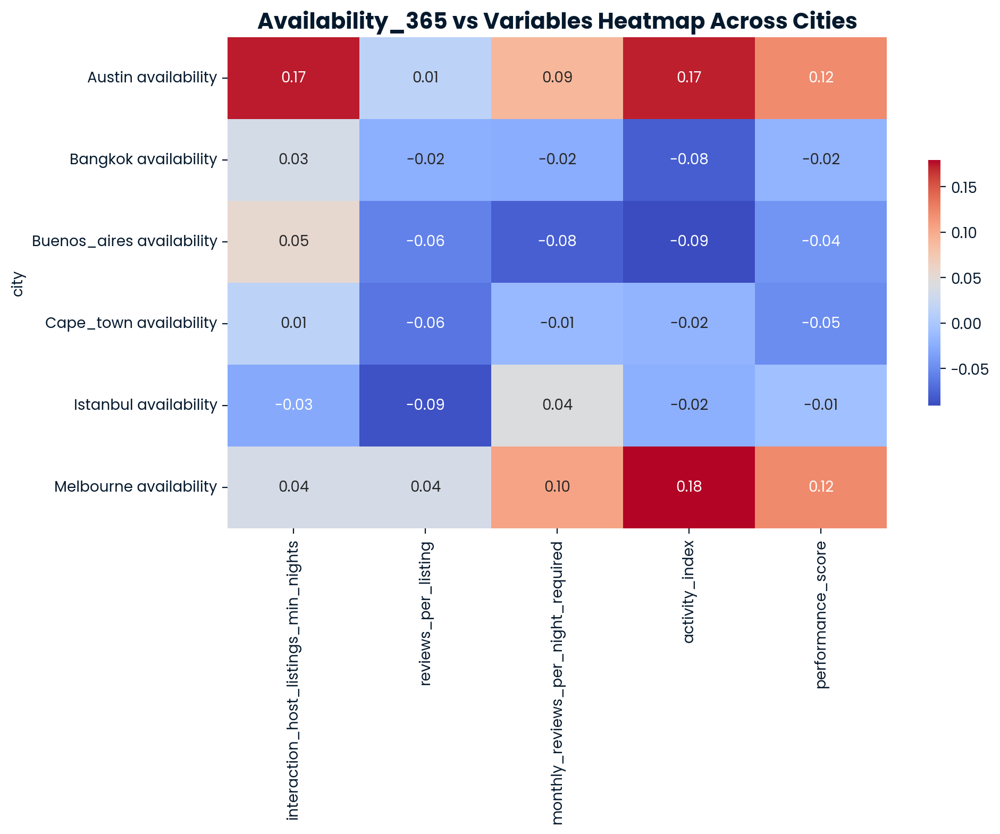

In [243]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'cities' is a list of unique cities in the 'listings' dataframe
cities = listings['city'].unique()

# Initialize an empty dataframe to store the combined correlation data
combined_corr_data = pd.DataFrame()

for city in cities:
    # Filter the listings for the current city
    city_listings = listings[listings['city'] == city]
    
    # Drop the columns 'id', 'host_id', 'available' and keep only the specified columns for correlation
    columns_of_interest = ['interaction_host_listings_min_nights', 'reviews_per_listing', 'monthly_reviews_per_night_required', 'activity_index', 'performance_score', 'availability_365']
    city_listings = city_listings[columns_of_interest]
    
    # Calculate the correlation matrix for the filtered city listings
    corr_city = city_listings.corr()
    
    # Extract the row for 'availability_365' to get its correlations with other specified variables
    corr_availability = corr_city.loc[['availability_365'], columns_of_interest[:-1]]  # Exclude 'availability_365' itself
    
    # Add a column to distinguish data from different cities
    corr_availability['city'] = city + " availability"
    
    # Append the data to the combined dataframe
    combined_corr_data = combined_corr_data.append(corr_availability)

# Set the 'city' column as the index to distinguish rows in the heatmap
combined_corr_data.set_index('city', inplace=True)

# Plot the heatmap for combined 'availability_365' correlations across all cities with specified variables
plt.figure(figsize=(10, 6))  # Adjusted figure size for better readability
sns.heatmap(combined_corr_data, annot=True, fmt=".2f", cmap='coolwarm', cbar_kws={'shrink': .5})
plt.title('Availability_365 vs Variables Heatmap Across Cities', fontsize=15, fontweight='bold')
plt.show()

# 6. Contribution Report
***
[Add words here]